# Question 1: Training a DC GAN
Here is the implementation of DC GAN with Binary Cross Entropy used as a loss function.

Using device: cuda


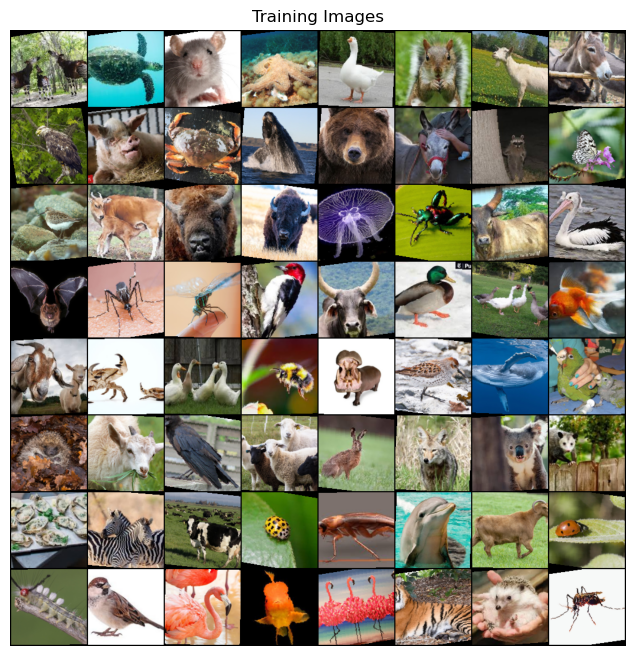

In [1]:
from torch_snippets import *
import torchvision
from torchvision import transforms
import torchvision.utils as vutils
import cv2, numpy as np, pandas as pd
import matplotlib.pyplot as plt

# import torch
import torch
import torch.nn as nn

device = "cuda" if torch.cuda.is_available() else "cpu"
print('Using device:', device)

transform = transforms.Compose([
    transforms.Resize(128),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.CenterCrop(128),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

dataFolder = '../animals'
dataset = torchvision.datasets.ImageFolder(root=dataFolder, transform=transform)

# Shuffle the data
dataloader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)

# Visualize few images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))

plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

# Generator

Weight Initializations and Defining the Generator and Discriminator Networks

In [3]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Update Discriminator to handle 128x128 images
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.model = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=32, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
        )
        
        self.apply(weights_init)
        
    def forward(self, x):
        return self.model(x)
    
    
# Update Generator to produce 128x128 images
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        
        self.model = nn.Sequential(
            nn.ConvTranspose2d(in_channels=150, out_channels=1024, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(1024),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )
        
        self.apply(weights_init)
        
    def forward(self, x):
        return self.model(x)
        

Check Model Summary

In [ ]:
# Discriminator summary
from torchsummary import summary
discriminator = Discriminator().to(device)
summary(discriminator, (3, 128, 128))

In [ ]:
generator = Generator().to(device)
summary(generator, (150, 1, 1))

Defining trainstep functions for Generator and Discriminator, setting up loss function + optimizers

In [ ]:
def discriminatorTrainStep(realData,fakeData):
    d_optimizer.zero_grad()
    predictionReal = discriminator(realData)
    errorReal = loss(predictionReal.squeeze(), torch.ones(len(realData)).to(device))
    errorReal.backward()
    
    predictionFake = discriminator(fakeData)
    errorFake = loss(predictionFake.squeeze(), torch.zeros(len(fakeData)).to(device))
    errorFake.backward()
    
    d_optimizer.step()  
    return errorReal + errorFake

def generatorTrainStep(fakeData):
    g_optimizer.zero_grad()
    prediction = discriminator(fakeData)
    error = loss(prediction.squeeze(), torch.ones(len(fakeData)).to(device))
    error.backward()
    g_optimizer.step()
    return error

discriminator = Discriminator().to(device)
generator = Generator().to(device)

# BCE Loss in case of Dc GAN
loss = nn.BCELoss()
d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
g_optimizer = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.7, 0.6))

Training Loop


In [ ]:
import torch
import torchvision.utils as vutils
import matplotlib.pyplot as plt
from tqdm import tqdm  # Import tqdm for progress visualization

# Assuming 'generator', 'discriminator', 'dataloader', and other necessary components are already defined

num_epoch = 100  # Set the number of epochs
d_loss_epoch = []
g_loss_epoch = []

for epoch in range(num_epoch):
    
    N = len(dataloader)
    d_loss_total = 0
    g_loss_total = 0

    # Set both generator and discriminator to training mode
    generator.train()
    discriminator.train()

    # Use tqdm to visualize progress
    with tqdm(total=N, desc=f'Epoch {epoch+1}/{num_epoch}') as pbar:
        for i, (realData, _) in enumerate(dataloader):
            
            realData = realData.to(device)

            # Generate fake data for discriminator training
            noise = torch.randn(len(realData), 150, 1, 1, device=device)
            fakeData = generator(noise).detach()

            # Train the discriminator
            dLoss = discriminatorTrainStep(realData, fakeData)
            d_loss_total += dLoss.item()  # Accumulate discriminator loss
            
            # Generate fake data for generator training
            noise = torch.randn(len(realData), 150, 1, 1, device=device)
            fakeData = generator(noise)

            # Train the generator
            gLoss = generatorTrainStep(fakeData)
            g_loss_total += gLoss.item()  # Accumulate generator loss
            
            # Update progress bar
            pbar.update(1)
            pbar.set_postfix(dLoss=dLoss.item(), gLoss=gLoss.item())
        
        # Calculate and store average losses for the epoch
        d_loss_avg = d_loss_total / N
        g_loss_avg = g_loss_total / N
        d_loss_epoch.append(d_loss_avg)
        g_loss_epoch.append(g_loss_avg)
        
    # Save generator samples every epoch
    generator.eval()
    with torch.no_grad():
        noise = torch.randn(64, 150, 1, 1, device=device)
        fakeData = generator(noise).cpu()
        vutils.save_image(fakeData, f'fake_samples_epoch.png', normalize=True)

    # Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
        torch.save(generator.state_dict(), f'generator_epoch_{epoch+1:03d}.pth')
        torch.save(discriminator.state_dict(), f'discriminator_epoch_{epoch+1:03d}.pth')

# Save the final models
torch.save(generator.state_dict(), 'generator_final_128.pth')
torch.save(discriminator.state_dict(), 'discriminator_final_128.pth')

# Plot the losses at the end of all epochs
plt.figure(figsize=(10, 5))
plt.plot(range(1, num_epoch + 1), d_loss_epoch, label='Discriminator Loss')
plt.plot(range(1, num_epoch + 1), g_loss_epoch, label='Generator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('Average Loss per Epoch')
plt.show()


Inference Function

In [ ]:
# generate 10*10 images
generator.eval()
with torch.no_grad():
    noise = torch.randn(100, 150, 1, 1, device=device)
    fakeData = generator(noise).cpu()
    vutils.save_image(fakeData, f'fake_samples_final.png', nrow=10, normalize=True)


# Question 2: Plotting 10 $\times$ 10 grid of generated images
Here are some of the generated images after training the model for 100 epochs and corresponding loss plots.

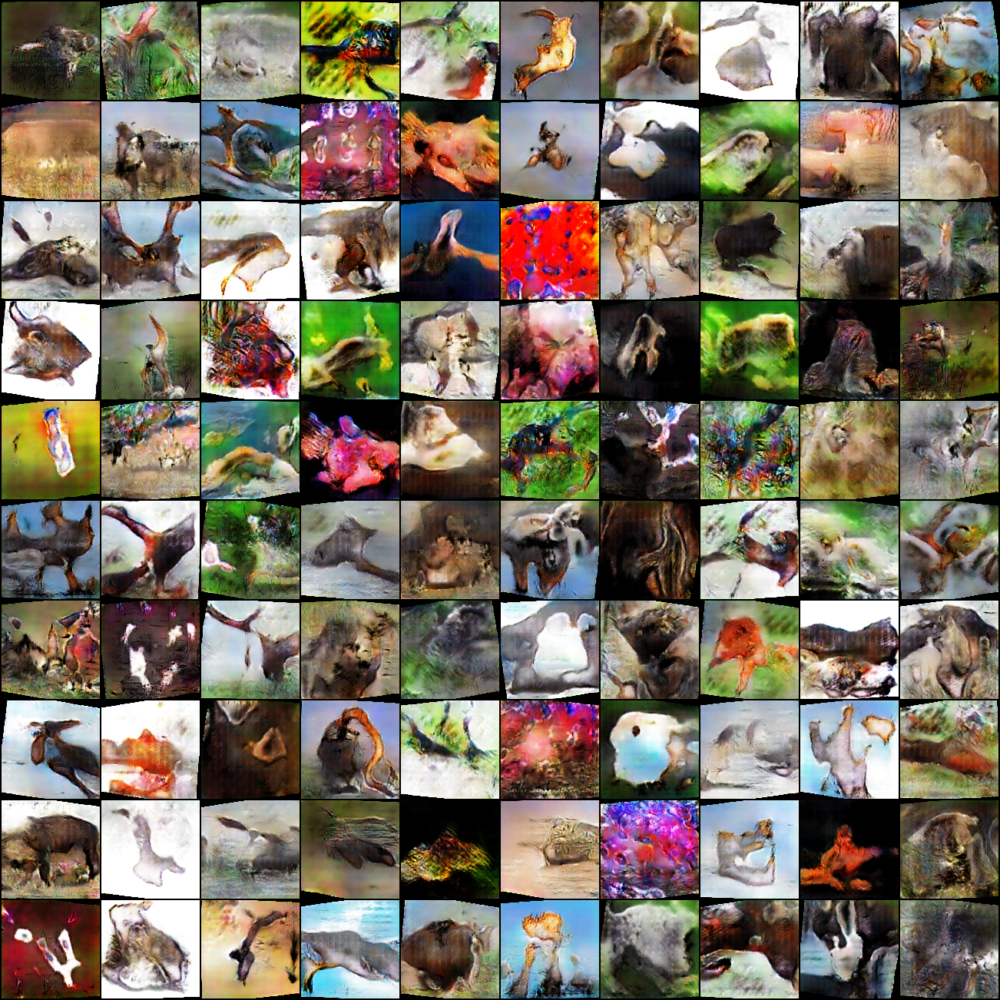

In [6]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='fake_samples_final.png'))


Here is the loss curves

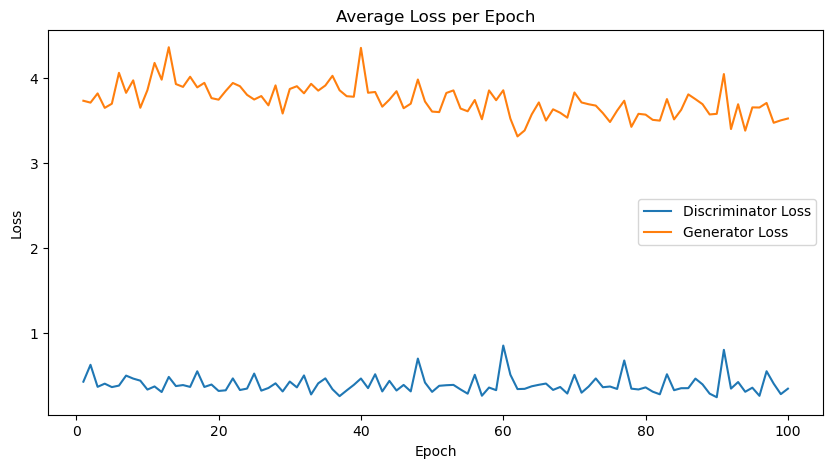

In [7]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='Q1loss.png'))


# Question 3: Varying the number of training steps
Here is the implementation in which we have varied training steps for discriminator and generator.

In [5]:
from torch_snippets import *
import torchvision
from torchvision import transforms
import torchvision.utils as vutils
import cv2, numpy as np, pandas as pd
import matplotlib.pyplot as plt
import torch
import torch.nn as nn

device = "cuda" if torch.cuda.is_available() else "cpu"
print('Using device:', device)

transform = transforms.Compose([
    transforms.Resize(128),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.CenterCrop(128),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

dataFolder = '../animals'
dataset = torchvision.datasets.ImageFolder(root=dataFolder, transform=transform)

# Shuffle the data
dataloader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)

# Visualize few images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))

plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
        
# Update Discriminator to handle 128x128 images
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.model = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=32, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
        )
        
        self.apply(weights_init)
        
    def forward(self, x):
        return self.model(x)
    
# Update Generator to produce 128x128 images
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        
        self.model = nn.Sequential(
            nn.ConvTranspose2d(in_channels=150, out_channels=1024, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(1024),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )
        
        self.apply(weights_init)
        
    def forward(self, x):
        return self.model(x)
    
def discriminatorTrainStep(realData,fakeData):
    d_optimizer.zero_grad()
    predictionReal = discriminator(realData)
    errorReal = loss(predictionReal.squeeze(), torch.ones(len(realData)).to(device))
    errorReal.backward()
    
    predictionFake = discriminator(fakeData)
    errorFake = loss(predictionFake.squeeze(), torch.zeros(len(fakeData)).to(device))
    errorFake.backward()
    
    d_optimizer.step()  
    return errorReal + errorFake

def generatorTrainStep(fakeData):
    g_optimizer.zero_grad()
    prediction = discriminator(fakeData)
    error = loss(prediction.squeeze(), torch.ones(len(fakeData)).to(device))
    error.backward()
    g_optimizer.step()
    return error

discriminator = Discriminator().to(device)
generator = Generator().to(device)

# BCE Loss in case of Dc GAN
loss = nn.BCELoss()
d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
g_optimizer = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.7, 0.6))

import torch
import torchvision.utils as vutils
import matplotlib.pyplot as plt
from tqdm import tqdm  # Import tqdm for progress visualization

# Assuming 'generator', 'discriminator', 'dataloader', and other necessary components are already defined

num_epoch = 200  # Set the number of epochs
d_loss_epoch = []
g_loss_epoch = []

# Set the number of times to train discriminator and generator per iteration
num_disc_steps = 3  # Number of discriminator updates per batch
num_gen_steps = 2   # Number of generator updates per batch

for epoch in range(num_epoch):
    
    N = len(dataloader)
    d_loss_total = 0
    g_loss_total = 0

    # Set both generator and discriminator to training mode
    generator.train()
    discriminator.train()

    # Use tqdm to visualize progress
    with tqdm(total=N, desc=f'Epoch {epoch+1}/{num_epoch}') as pbar:
        for i, (realData, _) in enumerate(dataloader):
            
            realData = realData.to(device)

            # Train the discriminator `num_disc_steps` times
            for _ in range(num_disc_steps):
                # Generate fake data for discriminator training
                noise = torch.randn(len(realData), 150, 1, 1, device=device)
                fakeData = generator(noise).detach()

                # Train the discriminator
                dLoss = discriminatorTrainStep(realData, fakeData)
                d_loss_total += dLoss.item()  # Accumulate discriminator loss

            # Train the generator `num_gen_steps` times
            for _ in range(num_gen_steps):
                # Generate fake data for generator training
                noise = torch.randn(len(realData), 150, 1, 1, device=device)
                fakeData = generator(noise)

                # Train the generator
                gLoss = generatorTrainStep(fakeData)
                g_loss_total += gLoss.item()  # Accumulate generator loss

            # Update progress bar
            pbar.update(1)
            pbar.set_postfix(dLoss=dLoss.item(), gLoss=gLoss.item())
        
        # Calculate and store average losses for the epoch
        d_loss_avg = d_loss_total / (N * num_disc_steps)
        g_loss_avg = g_loss_total / (N * num_gen_steps)
        d_loss_epoch.append(d_loss_avg)
        g_loss_epoch.append(g_loss_avg)
        
    # Save generator samples every epoch
    generator.eval()
    with torch.no_grad():
        noise = torch.randn(64, 150, 1, 1, device=device)
        fakeData = generator(noise).cpu()
        vutils.save_image(fakeData, f'fake_samples_epoch.png', normalize=True)

    # Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
        torch.save(generator.state_dict(), f'generator_epoch_{epoch+1:03d}.pth')
        torch.save(discriminator.state_dict(), f'discriminator_epoch_{epoch+1:03d}.pth')

# Save the final models
torch.save(generator.state_dict(), 'generator_final_128.pth')
torch.save(discriminator.state_dict(), 'discriminator_final_128.pth')

# Plot the losses at the end of all epochs
plt.figure(figsize=(10, 5))
plt.plot(range(1, num_epoch + 1), d_loss_epoch, label='Discriminator Loss')
plt.plot(range(1, num_epoch + 1), g_loss_epoch, label='Generator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('Average Loss per Epoch')
plt.show()

# Inference Function
# generate 10*10 images
generator.eval()
with torch.no_grad():
    noise = torch.randn(100, 150, 1, 1, device=device)
    fakeData = generator(noise).cpu()
    vutils.save_image(fakeData, f'fake_samples_final.png', nrow=10, normalize=True)


Here are generated images from this network after training for 300 epochs.

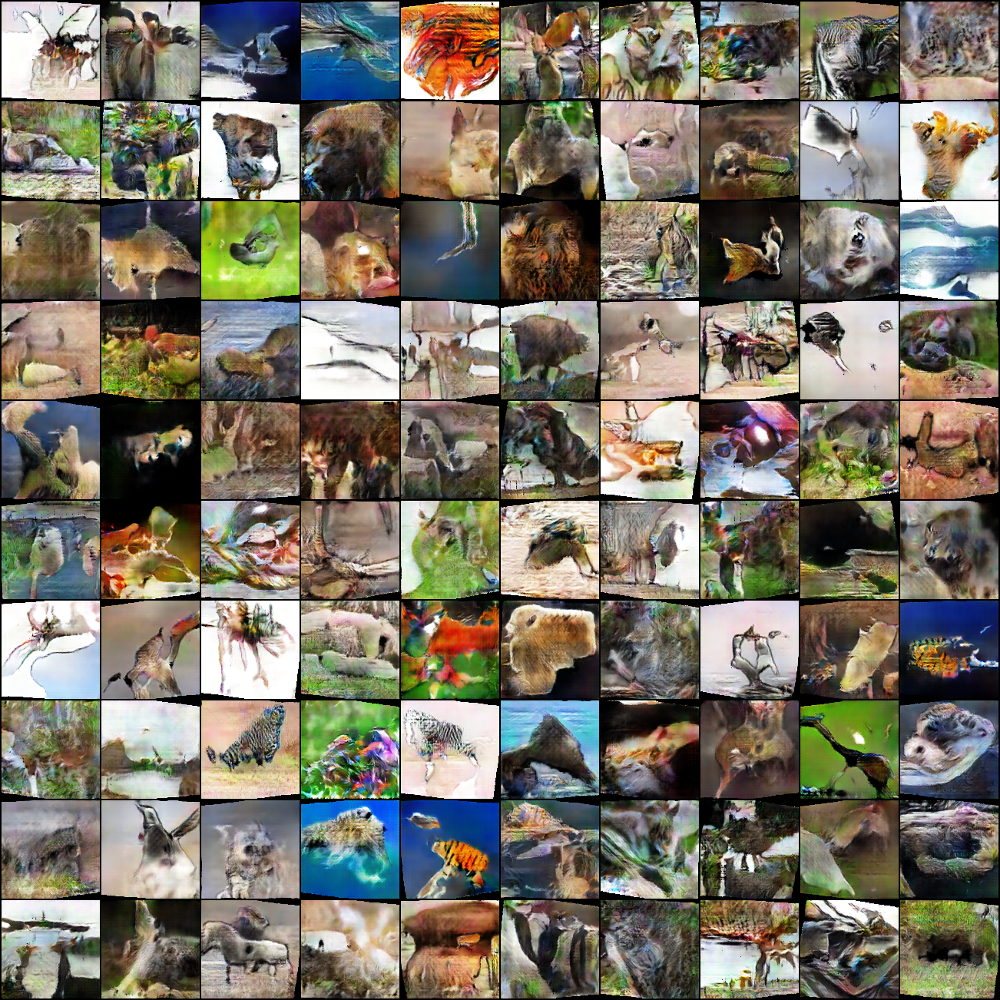

In [8]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='q3images.png'))


# Question 4: Calculating FID Score
Here is the implementation of FID score calculation for the generated images.

In [ ]:
import os
import torch
import numpy as np
from torchvision import transforms, models
from torch.utils.data import DataLoader, Dataset
from scipy.linalg import sqrtm
from PIL import Image
import torch.nn as nn

class CustomImageDataset(Dataset):
    def __init__(self, folder_path, transform=None):
        self.folder_path = folder_path
        self.transform = transform
        self.image_files = [
            os.path.join(folder_path, file)
            for file in os.listdir(folder_path)
            if file.lower().endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, index):
        img_path = self.image_files[index]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image

def calculate_fid(dataset1_path, dataset2_path, batch_size=50, dims=2048, device='cuda'):
    # Set up the InceptionV3 model
    inception_model = models.inception_v3(pretrained=True, transform_input=False)
    inception_model.fc = nn.Identity()  # Remove the final classification layer to get features
    inception_model.eval()
    inception_model.to(device)
    
    # Function to get Inception features
    def get_features(dataset_path):
        transform = transforms.Compose([
            transforms.Resize((299, 299)),  # Resize for InceptionV3 input
            transforms.ToTensor(),
            transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
        ])
        dataset = CustomImageDataset(dataset_path, transform=transform)
        dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)
        
        features = []
        with torch.no_grad():
            for imgs in dataloader:
                imgs = imgs.to(device)
                # Get features from the inception model
                feature = inception_model(imgs)
                features.append(feature.cpu().numpy())
        
        # Concatenate features from all batches
        features = np.concatenate(features, axis=0)
        return features
    
    # Get features for both datasets
    features1 = get_features(dataset1_path)
    features2 = get_features(dataset2_path)
    
    # Calculate mean and covariance of features for both datasets
    mu1, sigma1 = features1.mean(axis=0), np.cov(features1, rowvar=False)
    mu2, sigma2 = features2.mean(axis=0), np.cov(features2, rowvar=False)
    
    # Calculate the FID score using the formula:
    # FID = ||mu1 - mu2||^2 + trace(sigma1 + sigma2 - 2 * sqrt(sigma1 * sigma2))
    diff = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    
    # Numerical stability check for imaginary numbers in covmean
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    
    fid_score = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2 * covmean)
    return fid_score

# Example usage:
dataset1_path = 'generatedImages'
dataset2_path = 'sampled_animals'
fid_score = calculate_fid(dataset1_path, dataset2_path)
print(f"FID score between the datasets: {fid_score}")


## FID Scoes using above function
FID - 176.90 for (128 $\times$ 128) images

## FID Scores using Pytorch FID
This was discussed in teams that we can use Pytorch FID directly to compute the FID Scores. We are using the same here. Here are the FID scores for DC GAN model discussed in Q3 which was trained for 300 epochs.

I sampled 1000 images from model and took 1000 random images from given dataset
FID - 182.87 was obtained ( after resizing all images to 128 x 128)
FID - 190.78 was obtained ( after resizing all images to 256 x 256)

I normalized the images before calculating FID scores.
FID - 190.22 was obtained ( after resizing all images to 256 x 256)
FID - 188.25 was obtained ( after resizing all images to 128 x 128)

# Question 5: Latent Space Traversals
Here are 3 implementations of latent space traversals using the above model which was trained for 300 epochs.

First of all we need to load the weights file saved in previous implementation

In [ ]:
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

# Define the Generator class (as you provided)
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        
        self.model = nn.Sequential(
            nn.ConvTranspose2d(in_channels=150, out_channels=1024, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(1024),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )
        
    def forward(self, x):
        return self.model(x)

# Instantiate the generator and load the weights
generator = Generator()
generator.load_state_dict(torch.load('generator_epoch_300_300.pth'))
generator.eval()  # Set to evaluation mode


Check that model weights are loaded properly or not


In [ ]:
import numpy as np

# Set the latent dimension (input noise vector size)
latent_dim = 150

# Generate a few random latent vectors
num_samples = 5
latent_vectors = torch.randn(num_samples, latent_dim, 1, 1)

# Generate images using the generator
with torch.no_grad():
    generated_images = generator(latent_vectors)

# Convert the generated images to a grid for display
grid = make_grid(generated_images, nrow=num_samples, normalize=True)

# Plot the generated images
plt.figure(figsize=(15, 5))
plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
plt.axis('off')
plt.title('Generated Samples')
plt.show()


Linear Interpolation Code 1

In [ ]:
# Define the linear interpolation function
def linear_interpolation(z1, z2, steps=10):
    return [(1 - alpha) * z1 + alpha * z2 for alpha in np.linspace(0, 1, steps)]

# Number of interpolation sets
num_sets = 10
steps_per_set = 15

# Create a plot with 10 rows, each showing 10 interpolated images
fig, axs = plt.subplots(num_sets, steps_per_set, figsize=(20, 10), gridspec_kw={'wspace': 0, 'hspace': 0})

for row in range(num_sets):
    # Generate two random latent vectors
    z1 = torch.randn(1, 150, 1, 1)
    z2 = torch.randn(1, 150, 1, 1)
    interpolated_vectors = linear_interpolation(z1, z2, steps=steps_per_set)
    
    # Generate images from the interpolated vectors
    with torch.no_grad():
        images = [generator(z).squeeze(0) for z in interpolated_vectors]
    
    # Plot each image in the current row
    for col, img in enumerate(images):
        img = (img + 1) / 2  # Scale image from [-1, 1] to [0, 1]
        axs[row, col].imshow(img.permute(1, 2, 0).cpu().numpy())
        axs[row, col].axis('off')

# Remove extra space between plots
plt.subplots_adjust(wspace=0, hspace=0, top=0.95, bottom=0.05, left=0.05, right=0.95)

# Add a title to the plot
plt.suptitle('Latent Space Interpolations', fontsize=16)
plt.show()


Here are results from this interpolation


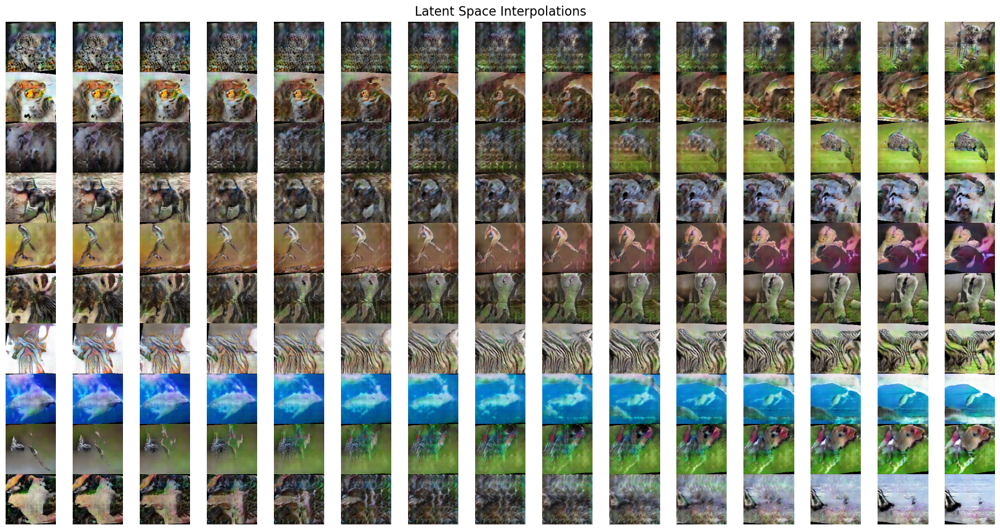

In [11]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='interpolation1.png'))


Linear Interpolation Code 2

In [ ]:
import torch.nn.functional as F

# Define the spherical interpolation (slerp) function
def slerp(z1, z2, steps=10):
    # Compute the angle between z1 and z2
    z1 = z1.squeeze(0)
    z2 = z2.squeeze(0)
    omega = torch.acos(F.cosine_similarity(z1, z2, dim=0))
    sin_omega = torch.sin(omega)
    
    # Generate interpolated vectors
    interpolated = [
        (torch.sin((1 - alpha) * omega) / sin_omega) * z1 +
        (torch.sin(alpha * omega) / sin_omega) * z2
        for alpha in np.linspace(0, 1, steps)
    ]
    
    # Reshape back to the input format of the generator
    return [z.unsqueeze(0) for z in interpolated]

# Number of interpolation sets
num_sets = 10
steps_per_set = 15

# Create a plot with 10 rows, each showing 10 interpolated images
fig, axs = plt.subplots(num_sets, steps_per_set, figsize=(20, 10), gridspec_kw={'wspace': 0, 'hspace': 0})

for row in range(num_sets):
    # Generate two random latent vectors
    z1 = torch.randn(1, 150, 1, 1)
    z2 = torch.randn(1, 150, 1, 1)
    interpolated_vectors = slerp(z1, z2, steps=steps_per_set)
    
    # Generate images from the interpolated vectors
    with torch.no_grad():
        images = [generator(z).squeeze(0) for z in interpolated_vectors]
    
    # Plot each image in the current row
    for col, img in enumerate(images):
        img = (img + 1) / 2  # Scale image from [-1, 1] to [0, 1]
        axs[row, col].imshow(img.permute(1, 2, 0).cpu().numpy())
        axs[row, col].axis('off')

# Remove extra space between plots
plt.subplots_adjust(wspace=0, hspace=0, top=0.95, bottom=0.05, left=0.05, right=0.95)

# Add a title to the plot
plt.suptitle('Non-Linear Interpolation (Slerp) between Latent Vectors', fontsize=16)
plt.show()

Here are the generated images from this interpolation

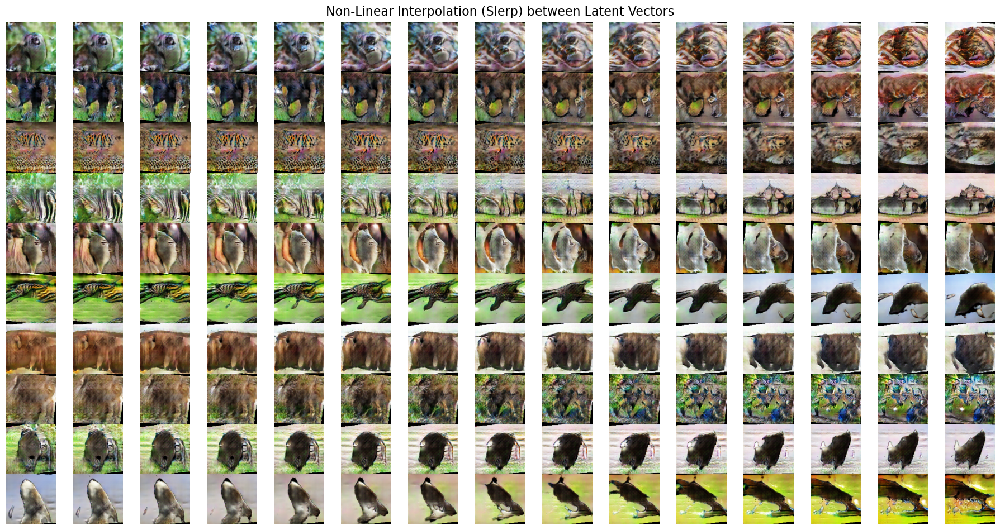

In [12]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='interpolation2.png'))


Interpolation Code 3

In [ ]:
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt

# Define the cubic interpolation function
def cubic_interpolation(z1, z2, steps=10):
    z1 = z1.squeeze(0)
    z2 = z2.squeeze(0)
    
    # Get points for interpolation
    t = np.linspace(0, 1, steps)

    # Cubic interpolation formula
    p0 = z1
    p1 = (z1 + z2) / 2
    p2 = (z1 + z2) / 2
    p3 = z2
    
    interpolated = [
        (1 - t_i)**3 * p0 + \
        3 * (1 - t_i)**2 * t_i * p1 + \
        3 * (1 - t_i) * t_i**2 * p2 + \
        t_i**3 * p3
        for t_i in t
    ]
    
    return [z.unsqueeze(0) for z in interpolated]

# Number of interpolation sets
num_sets = 10
steps_per_set = 15

# Create a plot with 10 rows, each showing 10 interpolated images
fig, axs = plt.subplots(num_sets, steps_per_set, figsize=(20, 10), gridspec_kw={'wspace': 0, 'hspace': 0})

for row in range(num_sets):
    # Generate two random latent vectors
    z1 = torch.randn(1, 150, 1, 1)
    z2 = torch.randn(1, 150, 1, 1)
    interpolated_vectors = cubic_interpolation(z1, z2, steps=steps_per_set)
    
    # Generate images from the interpolated vectors
    with torch.no_grad():
        images = [generator(z).squeeze(0) for z in interpolated_vectors]
    
    # Plot each image in the current row
    for col, img in enumerate(images):
        img = (img + 1) / 2  # Scale image from [-1, 1] to [0, 1]
        axs[row, col].imshow(img.permute(1, 2, 0).cpu().numpy())
        axs[row, col].axis('off')

# Remove extra space between plots
plt.subplots_adjust(wspace=0, hspace=0, top=0.95, bottom=0.05, left=0.05, right=0.95)

# Add a title to the plot
plt.suptitle('Smooth Traversal using Cubic Interpolation', fontsize=16)
plt.show()


Here are the generated images from this interpolation

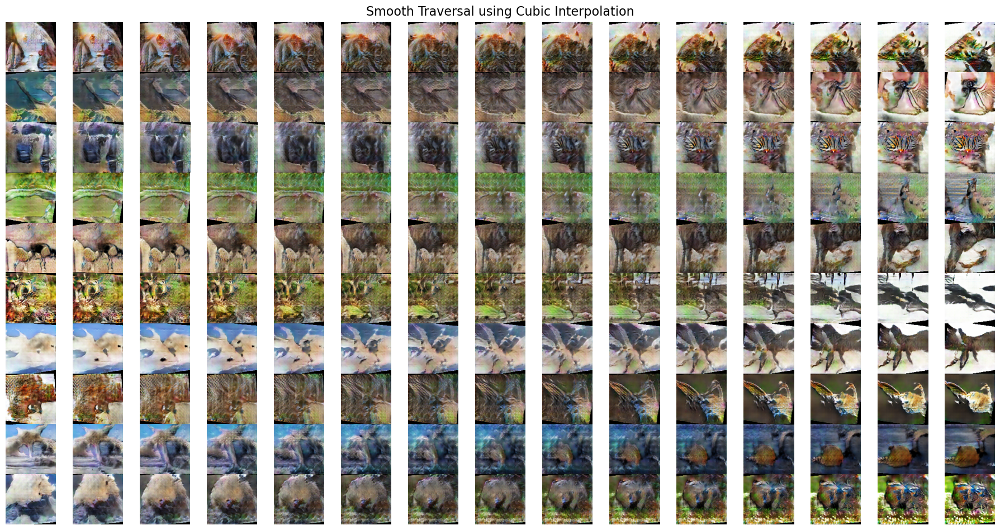

In [14]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='interpolations3.png'))


# Question 7: W GAN
Here is the implementation of W GAN with Wasserstein Loss used as a loss function.

In [ ]:
from torch_snippets import *
import torchvision
from torchvision import transforms
import torchvision.utils as vutils
import cv2, numpy as np, pandas as pd
import matplotlib.pyplot as plt
import torch
import torch.nn as nn

device = "cuda" if torch.cuda.is_available() else "cpu"
print('Using device:', device)

transform = transforms.Compose([
    transforms.Resize(128),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.CenterCrop(128),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

dataFolder = '../animals'
dataset = torchvision.datasets.ImageFolder(root=dataFolder, transform=transform)

# Shuffle the data
dataloader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)

# Visualize few images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))

plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
        
# Update Discriminator to handle 128x128 images
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.model = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=32, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
        )
        
        self.apply(weights_init)
        
    def forward(self, x):
        return self.model(x)
    
# Update Generator to produce 128x128 images
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        
        self.model = nn.Sequential(
            nn.ConvTranspose2d(in_channels=150, out_channels=1024, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(1024),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )
        
        self.apply(weights_init)
        
    def forward(self, x):
        return self.model(x)
    
def discriminatorTrainStep(realData, fakeData):
    d_optimizer.zero_grad()
    
    # Discriminator loss calculation for WGAN
    predictionReal = discriminator(realData)
    predictionFake = discriminator(fakeData)
    
    dLoss = -torch.mean(predictionReal) + torch.mean(predictionFake)
    dLoss.backward()
    
    d_optimizer.step()

    # Weight clipping for WGAN (required to enforce Lipschitz constraint)
    for param in discriminator.parameters():
        param.data.clamp_(-0.01, 0.01)
    
    return dLoss.item()

# Updated GeneratorTrainStep for WGAN
def generatorTrainStep(fakeData):
    g_optimizer.zero_grad()
    
    # Generator loss calculation for WGAN
    prediction = discriminator(fakeData)
    gLoss = -torch.mean(prediction)
    gLoss.backward()
    
    g_optimizer.step()
    return gLoss.item()

# Adjust the optimizers for WGAN
d_optimizer = torch.optim.RMSprop(discriminator.parameters(), lr=0.00005)
g_optimizer = torch.optim.RMSprop(generator.parameters(), lr=0.00005)

# Training Loop for WGAN
num_epoch = 300
d_loss_epoch = []
g_loss_epoch = []

# Adjust the number of discriminator and generator updates
num_disc_steps = 3  # Typically higher for WGAN (e.g., 5 discriminator updates per generator update)
num_gen_steps = 1   # One generator update per iteration

from tqdm import tqdm
import torch
import torchvision.utils as vutils
import matplotlib.pyplot as plt

# Assuming 'generator', 'discriminator', 'dataloader', 'discriminatorTrainStep', and 'generatorTrainStep' are already defined

num_epoch = 150  # Set the number of epochs
d_loss_epoch = []
g_loss_epoch = []

# Set the number of times to train discriminator and generator per iteration
num_disc_steps = 4  # Number of discriminator updates per batch
num_gen_steps = 3   # Number of generator updates per batch

for epoch in range(num_epoch):
    
    N = len(dataloader)
    d_loss_total = 0
    g_loss_total = 0

    generator.train()
    discriminator.train()

    # Use tqdm to visualize progress, adding emojis for a fun touch
    with tqdm(total=N, desc=f'💖 Epoch {epoch+1}/{num_epoch} 🎨') as pbar:
        for i, (realData, _) in enumerate(dataloader):
            
            realData = realData.to(device)

            # Train the discriminator `num_disc_steps` times
            for _ in range(num_disc_steps):
                noise = torch.randn(len(realData), 150, 1, 1, device=device)
                fakeData = generator(noise).detach()

                dLoss = discriminatorTrainStep(realData, fakeData)
                d_loss_total += dLoss

            # Train the generator `num_gen_steps` times
            for _ in range(num_gen_steps):
                noise = torch.randn(len(realData), 150, 1, 1, device=device)
                fakeData = generator(noise)

                gLoss = generatorTrainStep(fakeData)
                g_loss_total += gLoss

            # Update the progress bar with emojis in the postfix
            pbar.update(1)
            pbar.set_postfix(dLoss=f'🔴 {dLoss:.4f}', gLoss=f'💚 {gLoss:.4f}')
        
        # Calculate and store average losses for the epoch
        d_loss_avg = d_loss_total / (N * num_disc_steps)
        g_loss_avg = g_loss_total / (N * num_gen_steps)
        d_loss_epoch.append(d_loss_avg)
        g_loss_epoch.append(g_loss_avg)
        
    # Save generator samples every epoch
    generator.eval()
    with torch.no_grad():
        noise = torch.randn(64, 150, 1, 1, device=device)
        fakeData = generator(noise).cpu()
        vutils.save_image(fakeData, f'fake_samples_epoch2.png', normalize=True)

    # Save the model every 100 epochs
    if (epoch + 1) % 100 == 0:
        torch.save(generator.state_dict(), f'generator2_epoch_{epoch+1:03d}.pth')
        torch.save(discriminator.state_dict(), f'discriminator2_epoch_{epoch+1:03d}.pth')

# Save the final models
torch.save(generator.state_dict(), 'generator_final2.pth')
torch.save(discriminator.state_dict(), 'discriminator_final2.pth')

# Plot the losses at the end of all epochs
plt.figure(figsize=(10, 5))
plt.plot(range(1, num_epoch + 1), d_loss_epoch, label='🔴 Discriminator Loss')
plt.plot(range(1, num_epoch + 1), g_loss_epoch, label='💚 Generator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('💫 Average Loss per Epoch')
plt.show()


Here are the results for WGAN, with discriminator trained for 3 steps and generator trained for 1 step.

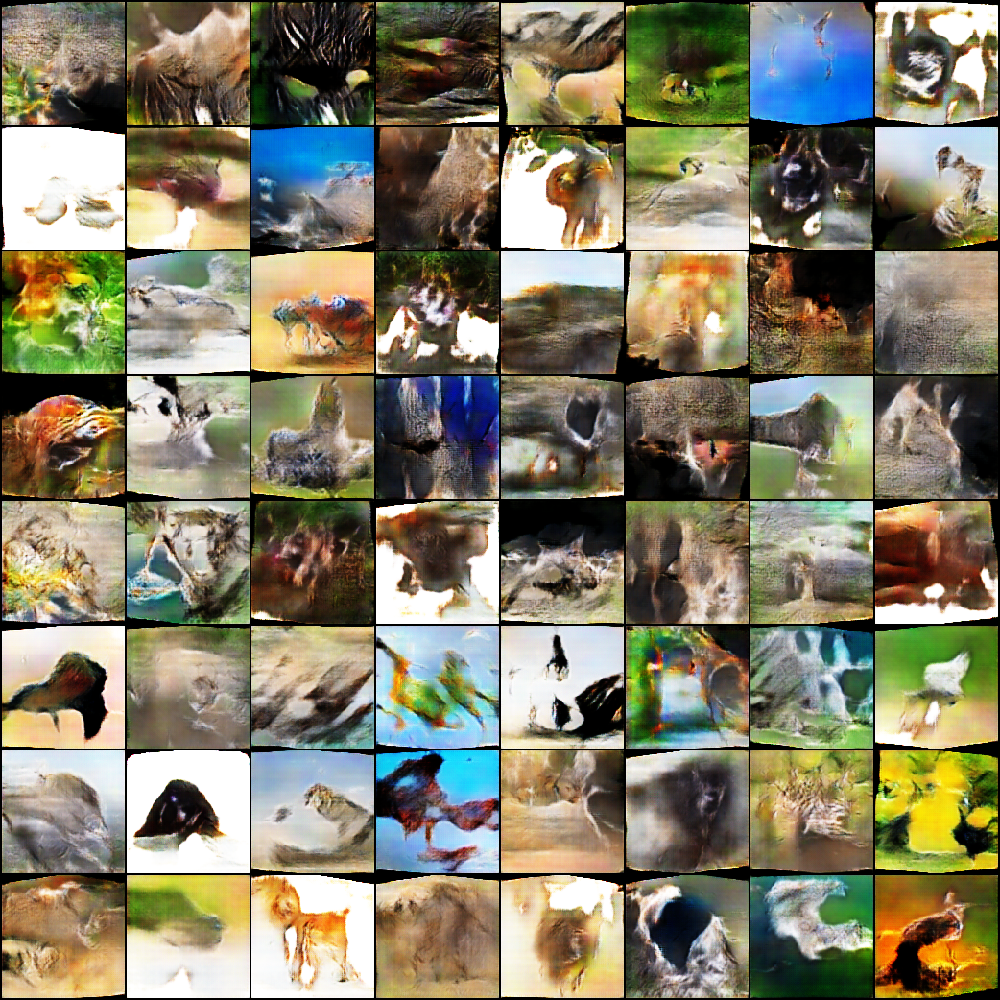

In [15]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='Q7images.png'))


Here is the loss curve for W GAN

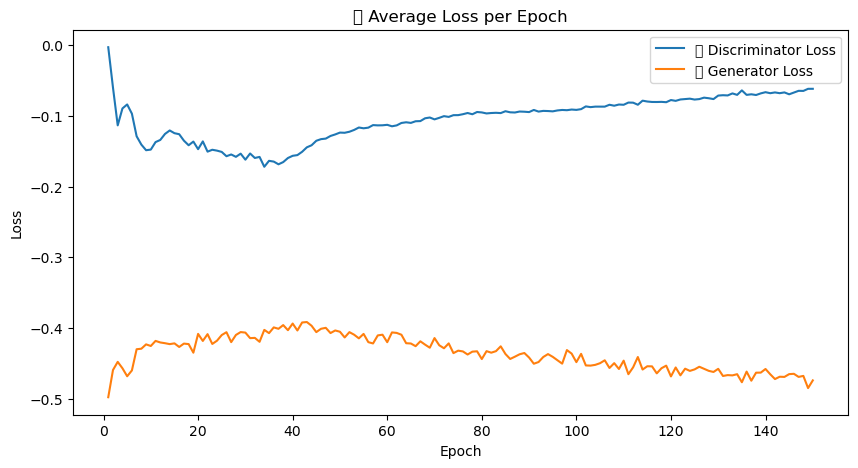

In [16]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='Q7loss.png'))


FID Score obtained from pytorch FID for W GAN model is 209.66
FID Score obtained from custom FID function for W GAN model is 192.83

As compared to DC GAN in Question 1, W GAN has higher FID score.

# Question 6: C GAN
In this problem we tried different architectures, and Transpose Convolutional layers worked best, In case of bilinear interpolation, the images were not clear.

Here is the implementation of C GAN 1

In [ ]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
import torchvision.utils as vutils
import matplotlib.pyplot as plt
from tqdm import tqdm

# Set random seed for reproducibility
torch.manual_seed(42)

# Parameters
BATCH_SIZE = 32
EPOCHS = 200
LATENT_DIM = 100
NUM_CLASSES = 20
IMAGE_SIZE = 128
CHANNELS = 3
LEARNING_RATE = 0.0002
BETA1 = 0.5

# Device configuration
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Data loading and preprocessing
transform = transforms.Compose([
    transforms.Resize(IMAGE_SIZE),
    transforms.CenterCrop(IMAGE_SIZE),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

dataset = datasets.ImageFolder(root="../animals", transform=transform)
dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4)

# Improved Generator model
class ImprovedGenerator(nn.Module):
    def __init__(self):
        super(ImprovedGenerator, self).__init__()
        self.label_emb = nn.Embedding(NUM_CLASSES, NUM_CLASSES)
        
        self.init_size = IMAGE_SIZE // 16  # Starting size after initial linear layer
        self.fc = nn.Linear(LATENT_DIM + NUM_CLASSES, 256 * self.init_size * self.init_size)
        
        self.conv_blocks = nn.Sequential(
            nn.BatchNorm2d(256),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True),
            nn.Conv2d(256, 256, 3, stride=1, padding=1),
            nn.BatchNorm2d(256, 0.8),
            nn.ReLU(True),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True),
            nn.Conv2d(256, 128, 3, stride=1, padding=1),
            nn.BatchNorm2d(128, 0.8),
            nn.ReLU(True),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True),
            nn.Conv2d(128, 64, 3, stride=1, padding=1),
            nn.BatchNorm2d(64, 0.8),
            nn.ReLU(True),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True),
            nn.Conv2d(64, CHANNELS, 3, stride=1, padding=1),
            nn.Tanh()
        )
    
    def forward(self, noise, labels):
        labels = self.label_emb(labels.long())  # Ensure labels are long
        x = torch.cat([noise, labels], 1)
        out = self.fc(x)
        out = out.view(out.shape[0], 256, self.init_size, self.init_size)
        img = self.conv_blocks(out)
        return img

# Improved Discriminator model
class ImprovedDiscriminator(nn.Module):
    def __init__(self):
        super(ImprovedDiscriminator, self).__init__()
        self.label_emb = nn.Embedding(NUM_CLASSES, NUM_CLASSES)
        
        def discriminator_block(in_filters, out_filters, bn=True):
            block = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1),
                     nn.LeakyReLU(0.2, inplace=True),
                     nn.Dropout2d(0.25)]
            if bn:
                block.append(nn.BatchNorm2d(out_filters, 0.8))
            return block

        self.model = nn.Sequential(
            *discriminator_block(CHANNELS, 64, bn=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
        )
        
        ds_size = IMAGE_SIZE // 2**4  # Downsampled size after 4 conv layers
        self.adv_layer = nn.Linear(512 * ds_size * ds_size + NUM_CLASSES, 1)
        self.aux_layer = nn.Linear(512 * ds_size * ds_size + NUM_CLASSES, NUM_CLASSES)

    def forward(self, img, labels):
        label_embedding = self.label_emb(labels.long()).view(labels.size(0), -1)  # Ensure labels are long
        img_features = self.model(img).view(img.size(0), -1)
        combined = torch.cat([img_features, label_embedding], 1)
        validity = self.adv_layer(combined)
        label_output = self.aux_layer(combined)
        return validity, label_output


# Initialize models
generator = ImprovedGenerator().to(device)
discriminator = ImprovedDiscriminator().to(device)

# Loss functions
adversarial_loss = nn.BCEWithLogitsLoss()
auxiliary_loss = nn.CrossEntropyLoss()

# Optimizers
g_optimizer = optim.Adam(generator.parameters(), lr=LEARNING_RATE, betas=(BETA1, 0.999))
d_optimizer = optim.Adam(discriminator.parameters(), lr=LEARNING_RATE, betas=(BETA1, 0.999))

# Training loop with tqdm and noise
def add_noise_to_labels(labels, noise_factor=0.1):
    noise = torch.randint(0, NUM_CLASSES, labels.size(), device=device)  # Random noise
    labels = (labels + noise * noise_factor) % NUM_CLASSES  # Add noise and wrap around
    return labels

def train_cgan():
    for epoch in range(EPOCHS):
        with tqdm(total=len(dataloader), desc=f"Epoch {epoch+1}/{EPOCHS} 🚀", unit="batch") as pbar:
            for i, (real_images, labels) in enumerate(dataloader):
                batch_size = real_images.size(0)
                real_images = real_images.to(device)

                # Ensure labels are LongTensor
                labels = labels.to(device).long()  # Convert labels to LongTensor

                # Create labels for real and fake images
                real_validity = torch.ones(batch_size, device=device)
                fake_validity = torch.zeros(batch_size, device=device)

                # Train Discriminator
                discriminator.zero_grad()
                
                # Real images
                real_output, real_labels = discriminator(real_images, labels)
                d_real_adv_loss = adversarial_loss(real_output[:, 0], real_validity)
                d_real_aux_loss = auxiliary_loss(real_labels, labels)
                d_real_loss = (d_real_adv_loss + d_real_aux_loss) / 2
                
                # Fake images
                noise = torch.randn(batch_size, LATENT_DIM, device=device)
                fake_images = generator(noise, labels)
                fake_output, fake_labels = discriminator(fake_images.detach(), labels)
                d_fake_adv_loss = adversarial_loss(fake_output[:, 0], fake_validity)
                d_fake_aux_loss = auxiliary_loss(fake_labels, labels)
                d_fake_loss = (d_fake_adv_loss + d_fake_aux_loss) / 2
                
                d_loss = (d_real_loss + d_fake_loss) / 2
                d_loss.backward()
                d_optimizer.step()

                # Train Generator
                generator.zero_grad()
                fake_images = generator(noise, labels)
                fake_output, fake_labels = discriminator(fake_images, labels)
                g_adv_loss = adversarial_loss(fake_output[:, 0], real_validity)
                g_aux_loss = auxiliary_loss(fake_labels, labels)
                g_loss = (g_adv_loss + g_aux_loss) / 2
                g_loss.backward()
                g_optimizer.step()

                # Update progress bar
                pbar.set_postfix(D_loss=d_loss.item(), G_loss=g_loss.item())
                pbar.update(1)

        print(f"🎉 Epoch [{epoch+1}/{EPOCHS}] completed! D_loss: {d_loss.item():.4f} | G_loss: {g_loss.item():.4f} 🖼️")

        # Save generated images
        with torch.no_grad():
            noise = torch.randn(64, LATENT_DIM, device=device)
            labels = torch.randint(0, NUM_CLASSES, (64,), device=device).long()  # Ensure LongTensor
            fake_images = generator(noise, labels)
            img_grid = vutils.make_grid(fake_images, normalize=True, nrow=8)
            plt.figure(figsize=(10, 10))
            plt.imshow(img_grid.permute(1, 2, 0).cpu().numpy())
            plt.axis('off')
            plt.savefig(f'generated_images_epoch.png')
            plt.close()


# Train the CGAN
train_cgan()

# Save the trained models
torch.save(generator.state_dict(), "improved_generator_model1.pth")
torch.save(discriminator.state_dict(), "improved_discriminator_model1.pth")


Here are the generated images from this model

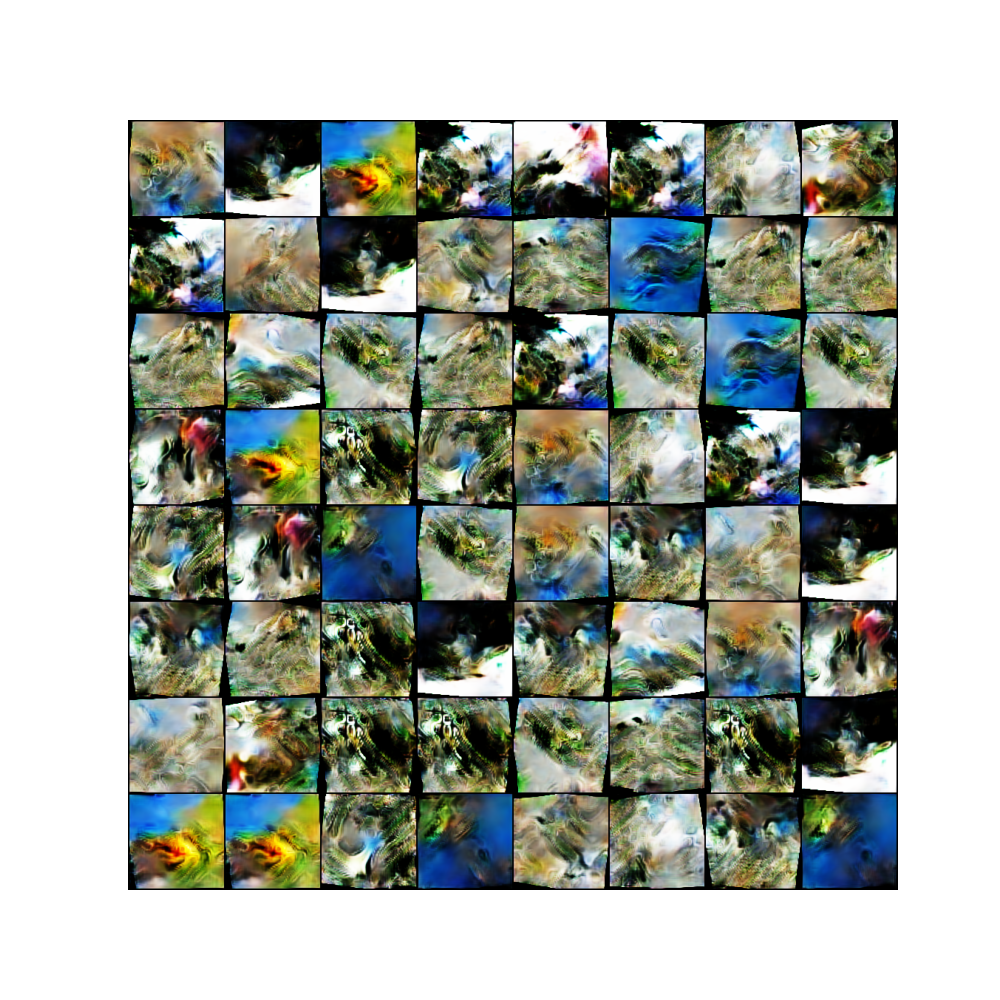

In [17]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='cgan1.png'))


C GAN 2, with bi linear interpolation. Here is the implementation

In [ ]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
import torchvision.utils as vutils
import matplotlib.pyplot as plt

# Set random seed for reproducibility
torch.manual_seed(42)

# Parameters
BATCH_SIZE = 32  # Reduced batch size
EPOCHS = 200  # Increased number of epochs
LATENT_DIM = 128  # Increased latent dimension
NUM_CLASSES = 20
IMAGE_SIZE = 128  # Increased image size
CHANNELS = 3
LEARNING_RATE = 0.0002
BETA1 = 0.5

# Device configuration
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Modified data loading and preprocessing
transform = transforms.Compose([
    transforms.Resize(IMAGE_SIZE),
    transforms.CenterCrop(IMAGE_SIZE),  # Add center crop to ensure fixed size
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

dataset = datasets.ImageFolder(root="../animals", transform=transform)
dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4)

# Generator model with spectral normalization
# Generator model with bilinear interpolation
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.label_emb = nn.Embedding(NUM_CLASSES, NUM_CLASSES)
        
        self.model = nn.Sequential(
            nn.Linear(LATENT_DIM + NUM_CLASSES, 8 * 8 * 512),
            nn.BatchNorm1d(8 * 8 * 512),
            nn.ReLU(True),
            nn.Unflatten(1, (512, 8, 8)),
        )
        
        self.upsample1 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True),  # Bilinear upsampling
            nn.Conv2d(512, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(True)
        )
        
        self.upsample2 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True),  # Bilinear upsampling
            nn.Conv2d(256, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True)
        )
        
        self.upsample3 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True),  # Bilinear upsampling
            nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(True)
        )
        
        self.final_layer = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True),  # Bilinear upsampling
            nn.Conv2d(64, CHANNELS, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

    def forward(self, noise, labels):
        labels = self.label_emb(labels)
        x = torch.cat([noise, labels], 1)
        x = self.model(x)
        
        x = self.upsample1(x)
        x = self.upsample2(x)
        x = self.upsample3(x)
        return self.final_layer(x)


# Discriminator model with spectral normalization
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.label_emb = nn.Embedding(NUM_CLASSES, 64 * IMAGE_SIZE * IMAGE_SIZE)
        
        self.model = nn.Sequential(
            nn.utils.spectral_norm(nn.Conv2d(CHANNELS, 64, 4, stride=2, padding=1)),
            nn.LeakyReLU(0.2, inplace=True),
            nn.utils.spectral_norm(nn.Conv2d(64, 128, 4, stride=2, padding=1)),
            nn.LeakyReLU(0.2, inplace=True),
            nn.utils.spectral_norm(nn.Conv2d(128, 256, 4, stride=2, padding=1)),
            nn.LeakyReLU(0.2, inplace=True),
            nn.utils.spectral_norm(nn.Conv2d(256, 512, 4, stride=2, padding=1)),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Flatten()
        )
        
        self.output = nn.utils.spectral_norm(nn.Linear(512 * 8 * 8 + 64 * IMAGE_SIZE * IMAGE_SIZE, NUM_CLASSES + 1))  # Adjusted size for IMAGE_SIZE=128

    def forward(self, img, labels):
        img_features = self.model(img)
        label_embedding = self.label_emb(labels).view(labels.size(0), -1)
        combined = torch.cat([img_features, label_embedding], 1)
        return self.output(combined)

# Initialize models
generator = Generator().to(device)
discriminator = Discriminator().to(device)

# Loss functions
adversarial_loss = nn.BCEWithLogitsLoss()
auxiliary_loss = nn.CrossEntropyLoss()

# Optimizers with adjusted learning rates
g_optimizer = optim.Adam(generator.parameters(), lr=LEARNING_RATE, betas=(BETA1, 0.999))
d_optimizer = optim.Adam(discriminator.parameters(), lr=LEARNING_RATE, betas=(BETA1, 0.999))

# Learning rate schedulers
g_scheduler = optim.lr_scheduler.ExponentialLR(g_optimizer, gamma=0.99)
d_scheduler = optim.lr_scheduler.ExponentialLR(d_optimizer, gamma=0.99)

# Training loop with improved stability techniques
def train_cgan():
    fixed_noise = torch.randn(64, LATENT_DIM, device=device)
    fixed_labels = torch.randint(0, NUM_CLASSES, (64,), device=device)

    for epoch in range(EPOCHS):
        for i, (real_images, labels) in enumerate(dataloader):
            batch_size = real_images.size(0)
            real_images = real_images.to(device)
            labels = labels.to(device)

            # Soft and noisy labels
            real_validity = torch.Tensor(batch_size).uniform_(0.8, 1.0).to(device)
            fake_validity = torch.Tensor(batch_size).uniform_(0.0, 0.2).to(device)

            # Train Discriminator
            discriminator.zero_grad()
            
            # Real images
            real_output = discriminator(real_images, labels)
            d_real_adv_loss = adversarial_loss(real_output[:, 0], real_validity)
            d_real_aux_loss = auxiliary_loss(real_output[:, 1:], labels)
            d_real_loss = d_real_adv_loss + d_real_aux_loss
            
            # Fake images
            noise = torch.randn(batch_size, LATENT_DIM, device=device)
            fake_images = generator(noise, labels)
            fake_output = discriminator(fake_images.detach(), labels)
            d_fake_adv_loss = adversarial_loss(fake_output[:, 0], fake_validity)
            d_fake_aux_loss = auxiliary_loss(fake_output[:, 1:], labels)
            d_fake_loss = d_fake_adv_loss + d_fake_aux_loss
            
            d_loss = (d_real_loss + d_fake_loss) / 2
            d_loss.backward()
            d_optimizer.step()

            # Train Generator
            generator.zero_grad()
            fake_images = generator(noise, labels)
            fake_output = discriminator(fake_images, labels)
            g_adv_loss = adversarial_loss(fake_output[:, 0], real_validity)
            g_aux_loss = auxiliary_loss(fake_output[:, 1:], labels)
            g_loss = g_adv_loss + g_aux_loss
            g_loss.backward()
            g_optimizer.step()

        # Update learning rates
        g_scheduler.step()
        d_scheduler.step()

        print(f"Epoch [{epoch+1}/{EPOCHS}] D_loss: {d_loss.item():.4f} G_loss: {g_loss.item():.4f}")

        # Save generated images
        with torch.no_grad():
            noise = torch.randn(64, LATENT_DIM, device=device)
            labels = torch.randint(0, NUM_CLASSES, (64,), device=device)
            fake_images = generator(noise, labels)
            img_grid = vutils.make_grid(fake_images, normalize=True, nrow=8)
            plt.figure(figsize=(10, 10))
            plt.imshow(img_grid.permute(1, 2, 0).cpu().numpy())
            plt.axis('off')
            plt.savefig(f'generated_images_epoch_3.png')
            plt.close()

# Train the CGAN
train_cgan()

# Save the trained models
torch.save(generator.state_dict(), "generator_model3.pth")
torch.save(discriminator.state_dict(), "discriminator_model3.pth")


Here are the generated outputs

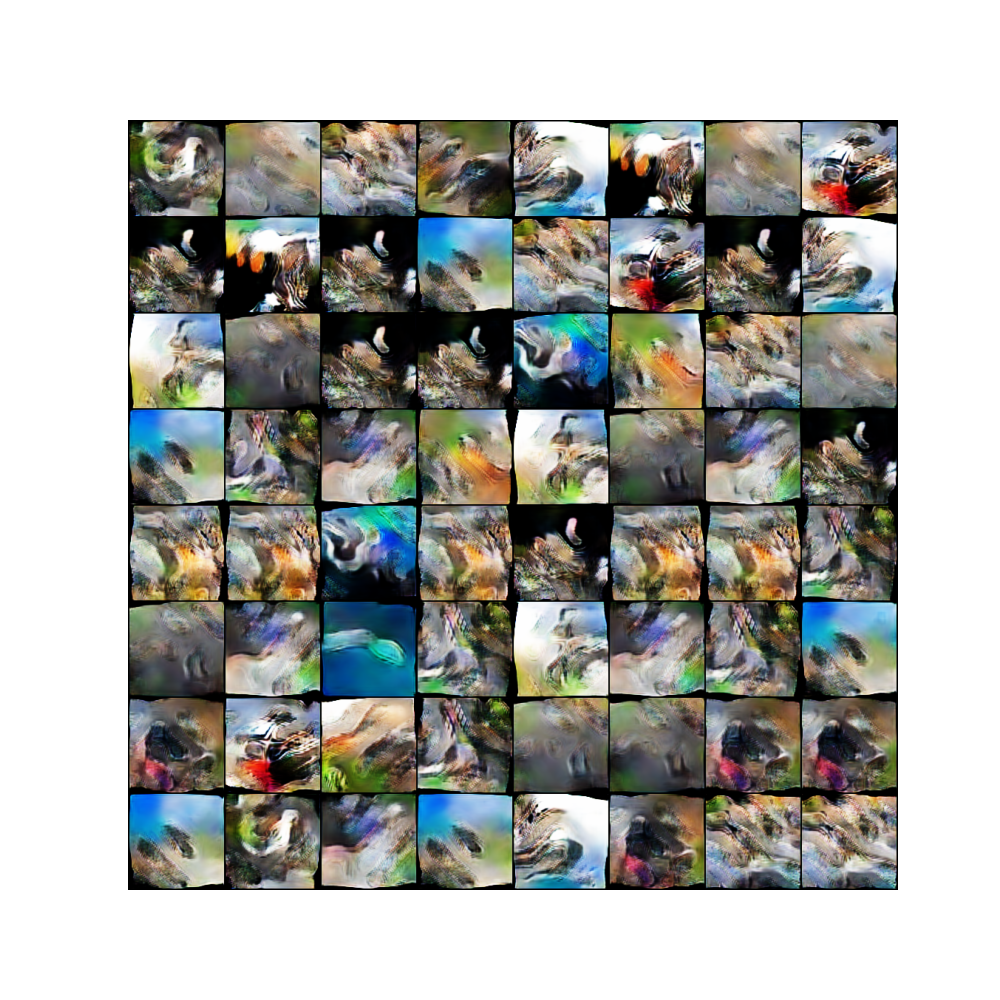

In [18]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='cgan2.png'))


C GANG 3, with spectral norm layers in discriminator. Here is the implementation

In [ ]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
import torchvision.utils as vutils
import matplotlib.pyplot as plt

# Set random seed for reproducibility
torch.manual_seed(42)

# Parameters
BATCH_SIZE = 32  # Reduced batch size
EPOCHS = 200  # Increased number of epochs
LATENT_DIM = 128  # Increased latent dimension
NUM_CLASSES = 20
IMAGE_SIZE = 128  # Increased image size
CHANNELS = 3
LEARNING_RATE = 0.0002
BETA1 = 0.5

# Device configuration
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Modified data loading and preprocessing
transform = transforms.Compose([
    transforms.Resize(IMAGE_SIZE),
    transforms.CenterCrop(IMAGE_SIZE),  # Add center crop to ensure fixed size
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

dataset = datasets.ImageFolder(root="../animals", transform=transform)
dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4)

# Generator model with spectral normalization
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.label_emb = nn.Embedding(NUM_CLASSES, NUM_CLASSES)
        
        self.model = nn.Sequential(
            nn.Linear(LATENT_DIM + NUM_CLASSES, 8 * 8 * 512),  # Adjust for input size 128
            nn.BatchNorm1d(8 * 8 * 512),
            nn.ReLU(True),
            nn.Unflatten(1, (512, 8, 8)),  # Adjust for new feature map size
            nn.ConvTranspose2d(512, 256, 4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, CHANNELS, 4, stride=2, padding=1),
            nn.Tanh()
        )

    def forward(self, noise, labels):
        labels = self.label_emb(labels)
        x = torch.cat([noise, labels], 1)
        return self.model(x)

# Discriminator model with spectral normalization
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.label_emb = nn.Embedding(NUM_CLASSES, 64 * IMAGE_SIZE * IMAGE_SIZE)
        
        self.model = nn.Sequential(
            nn.utils.spectral_norm(nn.Conv2d(CHANNELS, 64, 4, stride=2, padding=1)),
            nn.LeakyReLU(0.2, inplace=True),
            nn.utils.spectral_norm(nn.Conv2d(64, 128, 4, stride=2, padding=1)),
            nn.LeakyReLU(0.2, inplace=True),
            nn.utils.spectral_norm(nn.Conv2d(128, 256, 4, stride=2, padding=1)),
            nn.LeakyReLU(0.2, inplace=True),
            nn.utils.spectral_norm(nn.Conv2d(256, 512, 4, stride=2, padding=1)),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Flatten()
        )
        
        self.output = nn.utils.spectral_norm(nn.Linear(512 * 8 * 8 + 64 * IMAGE_SIZE * IMAGE_SIZE, NUM_CLASSES + 1))  # Adjusted size for IMAGE_SIZE=128

    def forward(self, img, labels):
        img_features = self.model(img)
        label_embedding = self.label_emb(labels).view(labels.size(0), -1)
        combined = torch.cat([img_features, label_embedding], 1)
        return self.output(combined)

# Initialize models
generator = Generator().to(device)
discriminator = Discriminator().to(device)

# Loss functions
adversarial_loss = nn.BCEWithLogitsLoss()
auxiliary_loss = nn.CrossEntropyLoss()

# Optimizers with adjusted learning rates
g_optimizer = optim.Adam(generator.parameters(), lr=LEARNING_RATE, betas=(BETA1, 0.999))
d_optimizer = optim.Adam(discriminator.parameters(), lr=LEARNING_RATE, betas=(BETA1, 0.999))

# Learning rate schedulers
g_scheduler = optim.lr_scheduler.ExponentialLR(g_optimizer, gamma=0.99)
d_scheduler = optim.lr_scheduler.ExponentialLR(d_optimizer, gamma=0.99)

# Training loop with improved stability techniques
def train_cgan():
    fixed_noise = torch.randn(64, LATENT_DIM, device=device)
    fixed_labels = torch.randint(0, NUM_CLASSES, (64,), device=device)

    for epoch in range(EPOCHS):
        for i, (real_images, labels) in enumerate(dataloader):
            batch_size = real_images.size(0)
            real_images = real_images.to(device)
            labels = labels.to(device)

            # Soft and noisy labels
            real_validity = torch.Tensor(batch_size).uniform_(0.8, 1.0).to(device)
            fake_validity = torch.Tensor(batch_size).uniform_(0.0, 0.2).to(device)

            # Train Discriminator
            discriminator.zero_grad()
            
            # Real images
            real_output = discriminator(real_images, labels)
            d_real_adv_loss = adversarial_loss(real_output[:, 0], real_validity)
            d_real_aux_loss = auxiliary_loss(real_output[:, 1:], labels)
            d_real_loss = d_real_adv_loss + d_real_aux_loss
            
            # Fake images
            noise = torch.randn(batch_size, LATENT_DIM, device=device)
            fake_images = generator(noise, labels)
            fake_output = discriminator(fake_images.detach(), labels)
            d_fake_adv_loss = adversarial_loss(fake_output[:, 0], fake_validity)
            d_fake_aux_loss = auxiliary_loss(fake_output[:, 1:], labels)
            d_fake_loss = d_fake_adv_loss + d_fake_aux_loss
            
            d_loss = (d_real_loss + d_fake_loss) / 2
            d_loss.backward()
            d_optimizer.step()

            # Train Generator
            generator.zero_grad()
            fake_images = generator(noise, labels)
            fake_output = discriminator(fake_images, labels)
            g_adv_loss = adversarial_loss(fake_output[:, 0], real_validity)
            g_aux_loss = auxiliary_loss(fake_output[:, 1:], labels)
            g_loss = g_adv_loss + g_aux_loss
            g_loss.backward()
            g_optimizer.step()

        # Update learning rates
        g_scheduler.step()
        d_scheduler.step()

        print(f"Epoch [{epoch+1}/{EPOCHS}] D_loss: {d_loss.item():.4f} G_loss: {g_loss.item():.4f}")

        # Save generated images
        with torch.no_grad():
            fake_images = generator(fixed_noise, fixed_labels)
            img_grid = vutils.make_grid(fake_images, normalize=True, nrow=8)
            plt.figure(figsize=(10, 10))
            plt.imshow(img_grid.permute(1, 2, 0).cpu().numpy())
            plt.axis('off')
            plt.savefig(f'generated_images_epoch_2.png')
            plt.close()

# Train the CGAN
train_cgan()

# Save the trained models
torch.save(generator.state_dict(), "generator_model2.pth")
torch.save(discriminator.state_dict(), "discriminator_model2.pth")

# Inference function
def generate_images(num_images=10, label=None):
    generator.eval()
    with torch.no_grad():
        noise = torch.randn(num_images, LATENT_DIM, device=device)
        if label is None:
            labels = torch.randint(0, NUM_CLASSES, (num_images,), device=device)
        else:
            labels = torch.full((num_images,), label, dtype=torch.long, device=device)
        fake_images = generator(noise, labels)
        return fake_images


Here are the generated outputs


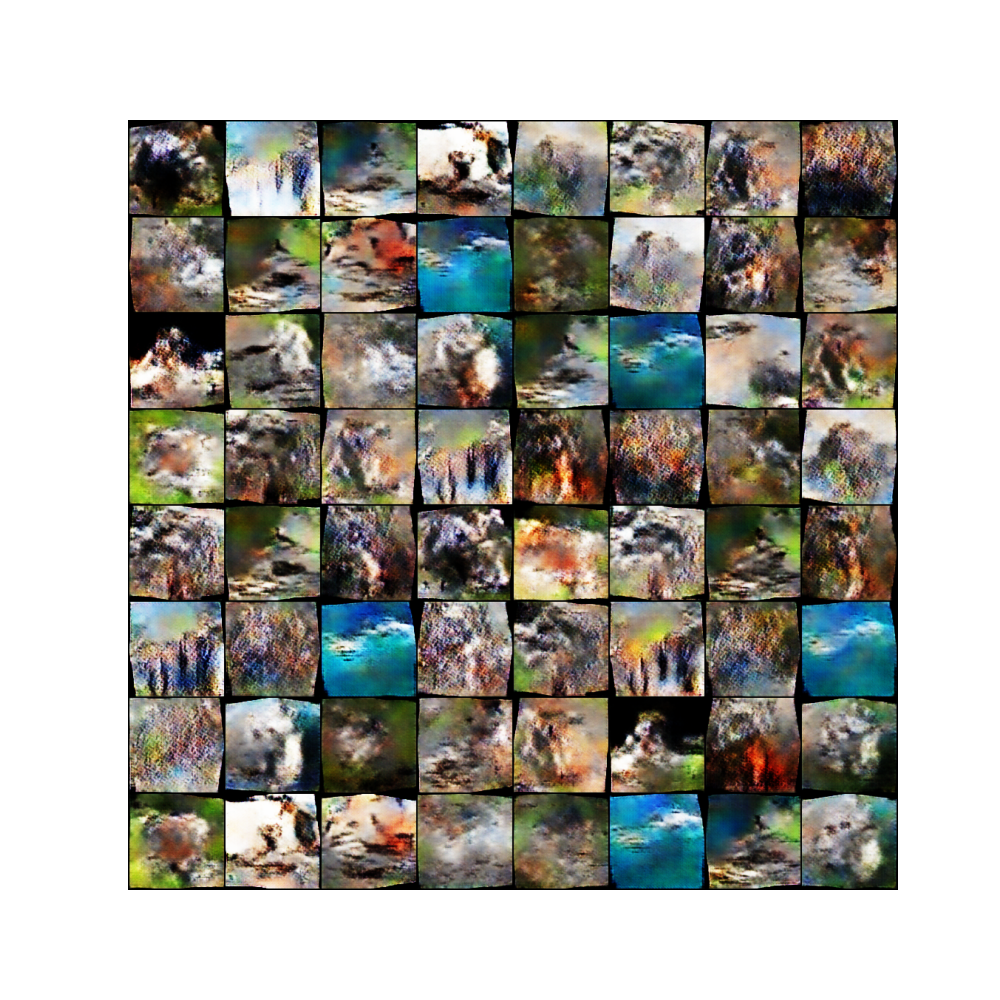

In [19]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='cgan3.png'))


Conditional Generation - Generating Images of Specific Class

We can use below function to generate images of specific class

In [ ]:
# Generate images for a specific class (e.g., class 0)
class_specific_images = generate_images(num_images=10, label=1)
img_grid = vutils.make_grid(class_specific_images, normalize=True, nrow=5)
plt.figure(figsize=(10, 10))
plt.imshow(img_grid.permute(1, 2, 0).cpu().numpy())
plt.axis('off')
plt.show()

Here are the results of conditional generation

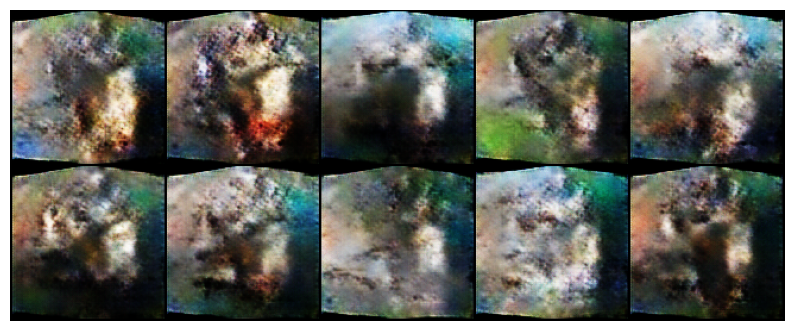

In [20]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='cgan4.png'))


# Q8

## Research Done

- The process of getting latent space representation of an image is called *Inversion* and the "decoder" mentioned in the assignment is called *Encoder* in the literature, attributing to the fact that an image is projected into the latent space $ z $. Also, as shown by Radford et al. in "Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks", algebraic operations in the latent space $ z $ of GAN lead to semantically meaningful synthetic samples in image space.

- According to Weihao Xia et al. in "A Survey on GAN Inversion", state of the art GAN Inversion happens in two ways:
  1. *Encoder Neural Network:* Here an entire neural network is trained for the inference of the latent space representation of an image. The loss used here is
     $$\theta_E^* = \arg\min_{\theta_E} \sum_n \mathcal{L}(G(E(x_n; \theta_E)), x_n)$$
     where $ \theta_E $ are encoder network parameters. This loss represents the loss (distance) between the given original image and the image generated by the Generator network where the input is the output of the Encoder on the original image instead of a random variable. For example, Donahue et al. in "Adversarial Feature Learning" describe this method.

  2. *Optimization based:* In this method, given an initial $ z $, it is then optimized to the actual value.
     $$\mathbf{z}^* = \arg\min_{\mathbf{z}} \ell(x, G(\mathbf{z}; \theta))$$
     No new Encoder neural network is trained here. For example, Creswell et al. in "Inverting the Generator of a Generative Adversarial Network" describe this approach. The loss used in the paper code is mean squared error (mse) loss between the given $ z $ and the output of the encoder.

- *What the question asks:* We are asked in the question to implement a decoder network (we will call this encoder network going forward to align ourselves with what is common in the current literature). The loss used must be mse loss between the input to the generator and the output of the encoder. In mathematical terms:
  $$\min_{\Theta_E} \mathcal{L}_E = \| \mathbf{z} - E(G(\mathbf{z})) \|_2$$
  where $ \theta_E $ are encoder parameters.

## Model Training

Now that we have the loss function, we are asked in the question to train the model along with regular GAN training losses. So, we try the following experimental setup:
1. Train the discriminator with separate real and fake batches, accumulate loss, backpropagate.
2. Train the Generator and Encoder together with total loss as the sum of mse-loss between $ z $ and $ E(G(z)) $ and regular GAN loss.
3. We try two variants, one with different noise used to train the Discriminator and Generator/Encoder and one with the same noise.

In [ ]:
import torchvision
from torchvision import transforms
import torchvision.utils as vutils
import cv2, numpy as np, pandas as pd
import matplotlib.pyplot as plt

import torch
import torch.nn as nn

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print('Using device:', device)

Using device: cuda


In [ ]:
transform = transforms.Compose([
    transforms.Resize(128),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.CenterCrop(128),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [ ]:
# there is animals folder, in which there are 90 folders, each folder contains images of a particular animal
# we will create a dataset from this folder
# We need to train a GAN, so no need to label the data

dataFolder = 'animals'
dataset = torchvision.datasets.ImageFolder(root=dataFolder, transform=transform)

# Shuffle the data
dataloader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)

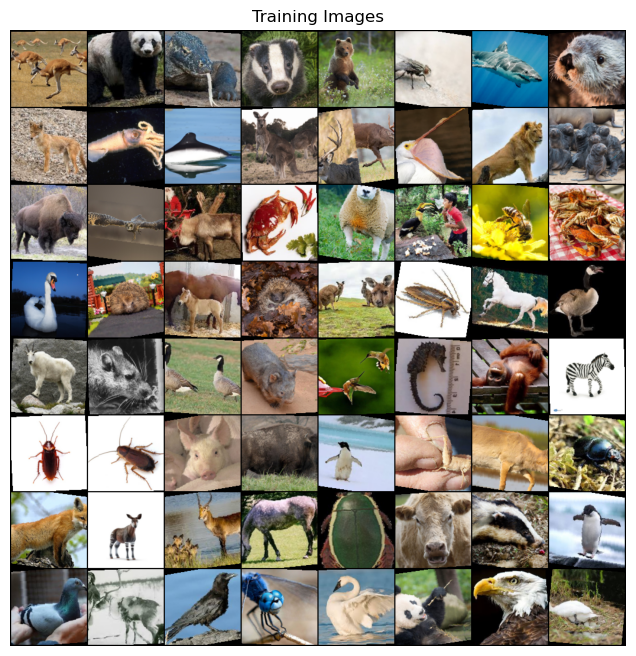

In [ ]:
# Visualize few images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))

plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [ ]:
def initialize_weights(net):
    for m in net.modules():
        if isinstance(m, nn.Conv2d):
            m.weight.data.normal_(0, 0.02)
            m.bias.data.zero_()
        elif isinstance(m, nn.ConvTranspose2d):
            m.weight.data.normal_(0, 0.02)
            m.bias.data.zero_()
        elif isinstance(m, nn.Linear):
            m.weight.data.normal_(0, 0.02)
            m.bias.data.zero_()

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
# Update Discriminator to handle 128x128 images
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.model = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=32, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
        )

        self.apply(weights_init)
        
    def forward(self, x):
        return self.model(x)

In [ ]:
# Discriminator summary
from torchsummary import summary
netD = Discriminator().to(device)
summary(netD, (3, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 64, 64]           1,536
         LeakyReLU-2           [-1, 32, 64, 64]               0
            Conv2d-3           [-1, 64, 32, 32]          32,768
         LeakyReLU-4           [-1, 64, 32, 32]               0
            Conv2d-5          [-1, 128, 16, 16]         131,072
       BatchNorm2d-6          [-1, 128, 16, 16]             256
         LeakyReLU-7          [-1, 128, 16, 16]               0
            Conv2d-8            [-1, 256, 8, 8]         524,288
       BatchNorm2d-9            [-1, 256, 8, 8]             512
        LeakyReLU-10            [-1, 256, 8, 8]               0
           Conv2d-11            [-1, 512, 4, 4]       2,097,152
      BatchNorm2d-12            [-1, 512, 4, 4]           1,024
        LeakyReLU-13            [-1, 512, 4, 4]               0
           Conv2d-14              [-1, 

In [ ]:
# Update Generator to produce 128x128 images
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        
        self.model = nn.Sequential(
            nn.ConvTranspose2d(in_channels=150, out_channels=1024, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(1024),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )
        
        self.apply(weights_init)
        
    def forward(self, x):
        return self.model(x)

In [ ]:
generator = Generator().to(device)
summary(generator, (150, 1, 1))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1           [-1, 1024, 4, 4]       2,457,600
       BatchNorm2d-2           [-1, 1024, 4, 4]           2,048
              ReLU-3           [-1, 1024, 4, 4]               0
   ConvTranspose2d-4            [-1, 512, 8, 8]       8,388,608
       BatchNorm2d-5            [-1, 512, 8, 8]           1,024
              ReLU-6            [-1, 512, 8, 8]               0
   ConvTranspose2d-7          [-1, 256, 16, 16]       2,097,152
       BatchNorm2d-8          [-1, 256, 16, 16]             512
              ReLU-9          [-1, 256, 16, 16]               0
  ConvTranspose2d-10          [-1, 128, 32, 32]         524,288
      BatchNorm2d-11          [-1, 128, 32, 32]             256
             ReLU-12          [-1, 128, 32, 32]               0
  ConvTranspose2d-13           [-1, 64, 64, 64]         131,072
      BatchNorm2d-14           [-1, 64,

In [ ]:
class Encoder(nn.Module):
    """
    CNN to model the encoder for Inverse GAN
    Input is vector X from image space if dimension X_dim=3x128x128
    Output is vector z from representation space of dimension z_dim=150
    """
    def __init__(self, z_dim=150):
        super(Encoder, self).__init__()

        self.input_height = 128
        self.input_width = 128
        self.input_dim = 1
        self.output_dim = z_dim

        self.slope = 0.02
        self.num_channels = 3

        self.inference = nn.Sequential(
            # input dim: num_channels x 128 x 128
            nn.Conv2d(self.num_channels, 32, 3, stride=1, padding=1, bias=True),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 32 x 128 x 128
            nn.Conv2d(32, 64, 4, stride=2, bias=True),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 64 x 63 x 63
            nn.Conv2d(64, 64, 4, stride=1, bias=True),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 64 x 60 x 60
            nn.Conv2d(64, 128, 4, stride=2, bias=True),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 128 x 29 x 29
            nn.Conv2d(128, 128, 4, stride=1, bias=True),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 128 x 26 x 26
            nn.Conv2d(128, 256, 1, stride=2, bias=True),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 256 x 13 x 13
            nn.Conv2d(256, 256, 4, stride=1, bias=True),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 256 x 10 x 10
            nn.Conv2d(256, 512, 4, stride=2, bias=True),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 512 x 4 x 4
            nn.Conv2d(512, 512, 4, stride=1, bias=True),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 512 x 1 x 1
            nn.Conv2d(512, z_dim, 1, stride=1, bias=True)
            # output dim: opt.z_dim x 1 x 1
        )

        self.apply(weights_init)

    def forward(self, input):
        x = self.inference(input)

        return x

In [ ]:
netE = Encoder()
initialize_weights(netE)

In [ ]:
from torchsummary import summary
summary(netE, (3, 128, 128), device='cpu')

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 128, 128]             896
       BatchNorm2d-2         [-1, 32, 128, 128]              64
         LeakyReLU-3         [-1, 32, 128, 128]               0
            Conv2d-4           [-1, 64, 63, 63]          32,832
       BatchNorm2d-5           [-1, 64, 63, 63]             128
         LeakyReLU-6           [-1, 64, 63, 63]               0
            Conv2d-7           [-1, 64, 60, 60]          65,600
       BatchNorm2d-8           [-1, 64, 60, 60]             128
         LeakyReLU-9           [-1, 64, 60, 60]               0
           Conv2d-10          [-1, 128, 29, 29]         131,200
      BatchNorm2d-11          [-1, 128, 29, 29]             256
        LeakyReLU-12          [-1, 128, 29, 29]               0
           Conv2d-13          [-1, 128, 26, 26]         262,272
      BatchNorm2d-14          [-1, 128,

In [ ]:
real_label = 1
fake_label = 0
z_dim = 150

fixed_noise = torch.randn(64, z_dim, 1, 1, device=device)

discriminator = Discriminator().to(device)
generator = Generator().to(device)
encoder = Encoder().to(device)

# BCE Loss in case of Dc GAN
criterion = nn.BCELoss()
mse_loss = nn.MSELoss()
d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
g_optimizer = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.7, 0.6))
e_optimizer = torch.optim.Adam(encoder.parameters(), lr=0.0002, betas=(0.7, 0.6))

In [ ]:
# Training Loop
num_epochs = 100

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
E_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        discriminator.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = discriminator(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, z_dim, 1, 1, device=device)
        # Generate fake image batch with G
        fake = generator(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = discriminator(fake).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        d_optimizer.step()

        ############################
        # (2) Update G and E network: maximize log(D(G(z))) + minimize reconstruction error
        ###########################
        generator.zero_grad()
        encoder.zero_grad()
        label.fill_(real_label)
        noise = torch.randn(b_size, z_dim, 1, 1, device=device)
        fake = generator(noise)
        output = discriminator(fake).view(-1)
        errG = criterion(output, label)
        z = encoder(fake)
        errE = mse_loss(z.squeeze(), noise)
        err = errG + errE
        err.backward()
        D_G_z2 = output.mean().item()
        g_optimizer.step()
        e_optimizer.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tLoss_E: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), errE.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        E_losses.append(errE.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = generator(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...


/home/pinakinc/miniconda3/envs/pydl/lib/python3.10/site-packages/torch/nn/modules/loss.py:538: UserWarning: Using a target size (torch.Size([64, 150, 1, 1])) that is different to the input size (torch.Size([64, 150])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


[0/100][0/85]	Loss_D: 1.6289	Loss_G: 3.5150	Loss_E: 1.0988	D(x): 0.3982	D(G(z)): 0.3665 / 0.0471
[0/100][50/85]	Loss_D: 0.1115	Loss_G: 11.1688	Loss_E: 1.0161	D(x): 0.9371	D(G(z)): 0.0000 / 0.0000


/home/pinakinc/miniconda3/envs/pydl/lib/python3.10/site-packages/torch/nn/modules/loss.py:538: UserWarning: Using a target size (torch.Size([24, 150, 1, 1])) that is different to the input size (torch.Size([24, 150])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


[1/100][0/85]	Loss_D: 0.2222	Loss_G: 14.4070	Loss_E: 1.0445	D(x): 0.8596	D(G(z)): 0.0002 / 0.0000
[1/100][50/85]	Loss_D: 0.8695	Loss_G: 3.5076	Loss_E: 0.9940	D(x): 0.7374	D(G(z)): 0.3062 / 0.0597
[2/100][0/85]	Loss_D: 0.8966	Loss_G: 2.8651	Loss_E: 1.0058	D(x): 0.6016	D(G(z)): 0.2113 / 0.1157
[2/100][50/85]	Loss_D: 0.8723	Loss_G: 2.1897	Loss_E: 1.0215	D(x): 0.7115	D(G(z)): 0.2615 / 0.1792
[3/100][0/85]	Loss_D: 0.3918	Loss_G: 2.3549	Loss_E: 0.9804	D(x): 0.8449	D(G(z)): 0.1661 / 0.1716
[3/100][50/85]	Loss_D: 0.7287	Loss_G: 2.9135	Loss_E: 1.0059	D(x): 0.7785	D(G(z)): 0.3321 / 0.1000
[4/100][0/85]	Loss_D: 0.3034	Loss_G: 6.9931	Loss_E: 1.0147	D(x): 0.8157	D(G(z)): 0.0083 / 0.0055
[4/100][50/85]	Loss_D: 0.1771	Loss_G: 5.1555	Loss_E: 1.0068	D(x): 0.9077	D(G(z)): 0.0640 / 0.0097
[5/100][0/85]	Loss_D: 0.1960	Loss_G: 4.5678	Loss_E: 0.9782	D(x): 0.8876	D(G(z)): 0.0503 / 0.0151
[5/100][50/85]	Loss_D: 0.5656	Loss_G: 2.6965	Loss_E: 1.0113	D(x): 0.7204	D(G(z)): 0.1222 / 0.1407
[6/100][0/85]	Loss_D: 1.

Loss: 0.8707718253135681


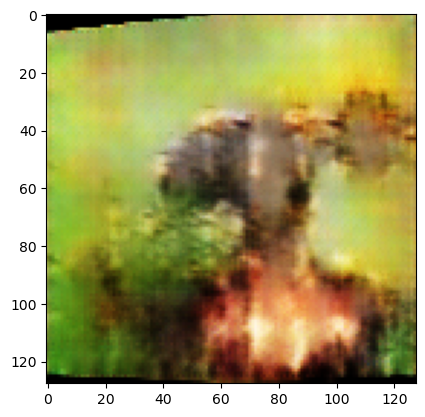

In [ ]:
# test generator and encoder
generator.eval()
encoder.eval()
with torch.no_grad():
    noise = torch.randn(1, z_dim, 1, 1, device=device)
    fake = generator(noise)
    z = encoder(fake)

    plt.imshow(np.transpose(vutils.make_grid(fake.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

    # calculate loss
    loss = mse_loss(z.squeeze(), noise)
    print('Loss:', loss.item())

In [ ]:
torch.save(encoder.state_dict(), 'encoder-2.pth')

## Q8 same noise

In [ ]:
transform = transforms.Compose([
    transforms.Resize(128),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.CenterCrop(128),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [ ]:
# there is animals folder, in which there are 90 folders, each folder contains images of a particular animal
# we will create a dataset from this folder
# We need to train a GAN, so no need to label the data

dataFolder = 'animals'
dataset = torchvision.datasets.ImageFolder(root=dataFolder, transform=transform)

# Shuffle the data
dataloader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)

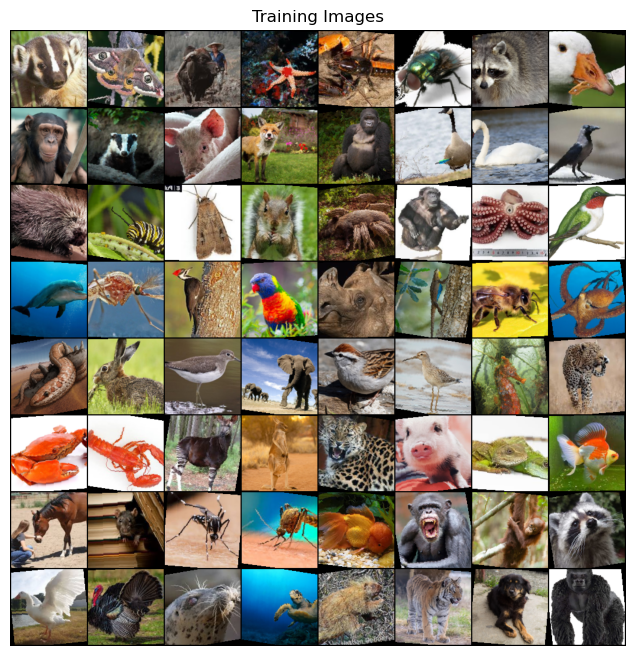

In [ ]:
# Visualize few images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))

plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [ ]:
def initialize_weights(net):
    for m in net.modules():
        if isinstance(m, nn.Conv2d):
            m.weight.data.normal_(0, 0.02)
            m.bias.data.zero_()
        elif isinstance(m, nn.ConvTranspose2d):
            m.weight.data.normal_(0, 0.02)
            m.bias.data.zero_()
        elif isinstance(m, nn.Linear):
            m.weight.data.normal_(0, 0.02)
            m.bias.data.zero_()

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
# Update Discriminator to handle 128x128 images
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.model = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=32, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
        )

        self.apply(weights_init)
        
    def forward(self, x):
        return self.model(x)

In [ ]:
# Discriminator summary
from torchsummary import summary
netD = Discriminator().to(device)
summary(netD, (3, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 64, 64]           1,536
         LeakyReLU-2           [-1, 32, 64, 64]               0
            Conv2d-3           [-1, 64, 32, 32]          32,768
         LeakyReLU-4           [-1, 64, 32, 32]               0
            Conv2d-5          [-1, 128, 16, 16]         131,072
       BatchNorm2d-6          [-1, 128, 16, 16]             256
         LeakyReLU-7          [-1, 128, 16, 16]               0
            Conv2d-8            [-1, 256, 8, 8]         524,288
       BatchNorm2d-9            [-1, 256, 8, 8]             512
        LeakyReLU-10            [-1, 256, 8, 8]               0
           Conv2d-11            [-1, 512, 4, 4]       2,097,152
      BatchNorm2d-12            [-1, 512, 4, 4]           1,024
        LeakyReLU-13            [-1, 512, 4, 4]               0
           Conv2d-14              [-1, 

In [ ]:
# Update Generator to produce 128x128 images
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        
        self.model = nn.Sequential(
            nn.ConvTranspose2d(in_channels=150, out_channels=1024, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(1024),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )
        
        self.apply(weights_init)
        
    def forward(self, x):
        return self.model(x)

In [ ]:
generator = Generator().to(device)
summary(generator, (150, 1, 1))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1           [-1, 1024, 4, 4]       2,457,600
       BatchNorm2d-2           [-1, 1024, 4, 4]           2,048
              ReLU-3           [-1, 1024, 4, 4]               0
   ConvTranspose2d-4            [-1, 512, 8, 8]       8,388,608
       BatchNorm2d-5            [-1, 512, 8, 8]           1,024
              ReLU-6            [-1, 512, 8, 8]               0
   ConvTranspose2d-7          [-1, 256, 16, 16]       2,097,152
       BatchNorm2d-8          [-1, 256, 16, 16]             512
              ReLU-9          [-1, 256, 16, 16]               0
  ConvTranspose2d-10          [-1, 128, 32, 32]         524,288
      BatchNorm2d-11          [-1, 128, 32, 32]             256
             ReLU-12          [-1, 128, 32, 32]               0
  ConvTranspose2d-13           [-1, 64, 64, 64]         131,072
      BatchNorm2d-14           [-1, 64,

In [ ]:
class Encoder(nn.Module):
    """
    CNN to model the encoder for Inverse GAN
    Input is vector X from image space if dimension X_dim=3x128x128
    Output is vector z from representation space of dimension z_dim=150
    """
    def __init__(self, z_dim=150):
        super(Encoder, self).__init__()

        self.input_height = 128
        self.input_width = 128
        self.input_dim = 1
        self.output_dim = z_dim

        self.slope = 0.02
        self.num_channels = 3

        self.inference = nn.Sequential(
            # input dim: num_channels x 128 x 128
            nn.Conv2d(self.num_channels, 32, 3, stride=1, padding=1, bias=True),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 32 x 128 x 128
            nn.Conv2d(32, 64, 4, stride=2, bias=True),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 64 x 63 x 63
            nn.Conv2d(64, 64, 4, stride=1, bias=True),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 64 x 60 x 60
            nn.Conv2d(64, 128, 4, stride=2, bias=True),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 128 x 29 x 29
            nn.Conv2d(128, 128, 4, stride=1, bias=True),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 128 x 26 x 26
            nn.Conv2d(128, 256, 1, stride=2, bias=True),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 256 x 13 x 13
            nn.Conv2d(256, 256, 4, stride=1, bias=True),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 256 x 10 x 10
            nn.Conv2d(256, 512, 4, stride=2, bias=True),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 512 x 4 x 4
            nn.Conv2d(512, 512, 4, stride=1, bias=True),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 512 x 1 x 1
            nn.Conv2d(512, z_dim, 1, stride=1, bias=True)
            # output dim: opt.z_dim x 1 x 1
        )

        self.apply(weights_init)

    def forward(self, input):
        x = self.inference(input)

        return x

In [ ]:
netE = Encoder()
initialize_weights(netE)

In [ ]:
from torchsummary import summary
summary(netE, (3, 128, 128), device='cpu')

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 128, 128]             896
       BatchNorm2d-2         [-1, 32, 128, 128]              64
         LeakyReLU-3         [-1, 32, 128, 128]               0
            Conv2d-4           [-1, 64, 63, 63]          32,832
       BatchNorm2d-5           [-1, 64, 63, 63]             128
         LeakyReLU-6           [-1, 64, 63, 63]               0
            Conv2d-7           [-1, 64, 60, 60]          65,600
       BatchNorm2d-8           [-1, 64, 60, 60]             128
         LeakyReLU-9           [-1, 64, 60, 60]               0
           Conv2d-10          [-1, 128, 29, 29]         131,200
      BatchNorm2d-11          [-1, 128, 29, 29]             256
        LeakyReLU-12          [-1, 128, 29, 29]               0
           Conv2d-13          [-1, 128, 26, 26]         262,272
      BatchNorm2d-14          [-1, 128,

In [ ]:
real_label = 1
fake_label = 0
z_dim = 150

fixed_noise = torch.randn(64, z_dim, 1, 1, device=device)

discriminator = Discriminator().to(device)
generator = Generator().to(device)
encoder = Encoder().to(device)

# BCE Loss in case of Dc GAN
criterion = nn.BCELoss()
mse_loss = nn.MSELoss()
d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
g_optimizer = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.7, 0.6))
e_optimizer = torch.optim.Adam(encoder.parameters(), lr=0.0002, betas=(0.7, 0.6))

In [ ]:
# Training Loop
num_epochs = 100

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
E_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        discriminator.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = discriminator(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, z_dim, 1, 1, device=device)
        # Generate fake image batch with G
        fake = generator(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = discriminator(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        d_optimizer.step()

        # ############################
        # # (2) Update G network: maximize log(D(G(z)))
        # ###########################
        # generator.zero_grad()
        # label.fill_(real_label)  # fake labels are real for generator cost
        # # Since we just updated D, perform another forward pass of all-fake batch through D
        # output = discriminator(fake).view(-1)
        # # Calculate G's loss based on this output
        # errG = criterion(output, label)
        # # Calculate gradients for G
        # errG.backward()
        # D_G_z2 = output.mean().item()
        # # Update G
        # g_optimizer.step()

        # ############################
        # # (3) Update E network: minimize reconstruction error
        # ###########################
        # encoder.zero_grad()
        # noise = noise.view(-1, 150, 1, 1)
        # z = encoder(fake)
        # errE = mse_loss(z.squeeze(), noise)
        # errE.backward()
        # e_optimizer.step()

        ############################
        # (2) Update G and E network: maximize log(D(G(z))) + minimize reconstruction error
        ###########################
        generator.zero_grad()
        encoder.zero_grad()
        label.fill_(real_label)
        output = discriminator(fake).view(-1)
        errG = criterion(output, label)
        z = encoder(fake)
        errE = mse_loss(z.squeeze(), noise)
        err = errG + errE
        err.backward()
        D_G_z2 = output.mean().item()
        g_optimizer.step()
        e_optimizer.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tLoss_E: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), errE.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        E_losses.append(errE.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = generator(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...


/home/pinakinc/miniconda3/envs/pydl/lib/python3.10/site-packages/torch/nn/modules/loss.py:538: UserWarning: Using a target size (torch.Size([64, 150, 1, 1])) that is different to the input size (torch.Size([64, 150])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


[0/100][0/85]	Loss_D: 1.6530	Loss_G: 7.4088	Loss_E: 1.0838	D(x): 0.6596	D(G(z)): 0.6205 / 0.0008
[0/100][50/85]	Loss_D: 0.6014	Loss_G: 27.0933	Loss_E: 1.0349	D(x): 0.6455	D(G(z)): 0.0000 / 0.0000


/home/pinakinc/miniconda3/envs/pydl/lib/python3.10/site-packages/torch/nn/modules/loss.py:538: UserWarning: Using a target size (torch.Size([24, 150, 1, 1])) that is different to the input size (torch.Size([24, 150])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


[1/100][0/85]	Loss_D: 1.0569	Loss_G: 3.7948	Loss_E: 1.0119	D(x): 0.5805	D(G(z)): 0.1016 / 0.0406
[1/100][50/85]	Loss_D: 1.1609	Loss_G: 2.6548	Loss_E: 1.0123	D(x): 0.6748	D(G(z)): 0.3570 / 0.1199
[2/100][0/85]	Loss_D: 0.7389	Loss_G: 4.7195	Loss_E: 1.0112	D(x): 0.9509	D(G(z)): 0.4322 / 0.0247
[2/100][50/85]	Loss_D: 0.3099	Loss_G: 5.4843	Loss_E: 0.9940	D(x): 0.9142	D(G(z)): 0.1543 / 0.0078
[3/100][0/85]	Loss_D: 0.5322	Loss_G: 10.6996	Loss_E: 0.9681	D(x): 0.9746	D(G(z)): 0.3202 / 0.0001
[3/100][50/85]	Loss_D: 0.2690	Loss_G: 4.5660	Loss_E: 1.0325	D(x): 0.8614	D(G(z)): 0.0640 / 0.0247
[4/100][0/85]	Loss_D: 0.1853	Loss_G: 4.7923	Loss_E: 0.9784	D(x): 0.8726	D(G(z)): 0.0337 / 0.0150
[4/100][50/85]	Loss_D: 0.5089	Loss_G: 2.4937	Loss_E: 1.0048	D(x): 0.7162	D(G(z)): 0.0591 / 0.1235
[5/100][0/85]	Loss_D: 0.3783	Loss_G: 3.4622	Loss_E: 1.0099	D(x): 0.7918	D(G(z)): 0.0665 / 0.0487
[5/100][50/85]	Loss_D: 0.3946	Loss_G: 3.2078	Loss_E: 0.9644	D(x): 0.7579	D(G(z)): 0.0074 / 0.1885
[6/100][0/85]	Loss_D: 0.

Loss: 0.7589932084083557


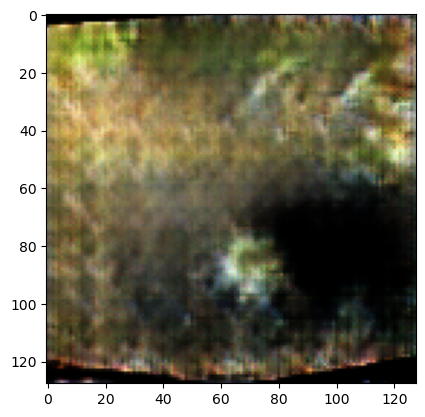

In [ ]:
# test generator and encoder
generator.eval()
encoder.eval()
with torch.no_grad():
    noise = torch.randn(1, z_dim, 1, 1, device=device)
    fake = generator(noise)
    z = encoder(fake)

    plt.imshow(np.transpose(vutils.make_grid(fake.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

    # calculate loss
    loss = mse_loss(z.squeeze(), noise)
    print('Loss:', loss.item())

In [ ]:
torch.save(encoder.state_dict(), 'encoder.pth')

# Q9

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, transforms
from sklearn.metrics import accuracy_score, f1_score
import numpy as np
from tqdm import tqdm

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
class Encoder(nn.Module):
    """
    CNN to model the encoder for Inverse GAN
    Input is vector X from image space if dimension X_dim=3x128x128
    Output is vector z from representation space of dimension z_dim=150
    """
    def __init__(self, z_dim=150):
        super(Encoder, self).__init__()

        self.input_height = 128
        self.input_width = 128
        self.input_dim = 1
        self.output_dim = z_dim

        self.slope = 0.02
        self.num_channels = 3

        self.inference = nn.Sequential(
            # input dim: num_channels x 128 x 128
            nn.Conv2d(self.num_channels, 32, 3, stride=1, padding=1, bias=True),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 32 x 128 x 128
            nn.Conv2d(32, 64, 4, stride=2, bias=True),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 64 x 63 x 63
            nn.Conv2d(64, 64, 4, stride=1, bias=True),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 64 x 60 x 60
            nn.Conv2d(64, 128, 4, stride=2, bias=True),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 128 x 29 x 29
            nn.Conv2d(128, 128, 4, stride=1, bias=True),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 128 x 26 x 26
            nn.Conv2d(128, 256, 1, stride=2, bias=True),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 256 x 13 x 13
            nn.Conv2d(256, 256, 4, stride=1, bias=True),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 256 x 10 x 10
            nn.Conv2d(256, 512, 4, stride=2, bias=True),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 512 x 4 x 4
            nn.Conv2d(512, 512, 4, stride=1, bias=True),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(self.slope, inplace=True),
            # state dim: 512 x 1 x 1
            nn.Conv2d(512, z_dim, 1, stride=1, bias=True)
            # output dim: opt.z_dim x 1 x 1
        )

        self.apply(weights_init)

    def forward(self, input):
        x = self.inference(input)

        return x


In [ ]:
class MLP(nn.Module):
    def __init__(self, input_dim=1, hidden_dim=256, num_classes=90):
        super(MLP, self).__init__()
        self.main = nn.Sequential(
            nn.Flatten(),  # Flatten input if necessary
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(hidden_dim, hidden_dim // 2),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(hidden_dim // 2, num_classes)
        )
        
    def forward(self, x):
        # Print shape for debugging
        # print(f"Input shape to MLP: {x.shape}")
        return self.main(x)


In [ ]:
def encode_dataset(encoder, dataloader, device):
    encoded_features = []
    labels = []
    
    encoder.eval()
    with torch.no_grad():
        for batch_images, batch_labels in tqdm(dataloader, desc="Encoding images"):
            batch_images = batch_images.to(device)
            features = encoder(batch_images)
            
            # Print shape for first batch
            if len(encoded_features) == 0:
                print(f"Single batch encoder output shape: {features.shape}")
            
            encoded_features.append(features.cpu())
            labels.append(batch_labels)
    
    encoded_features = torch.cat(encoded_features, dim=0)
    labels = torch.cat(labels, dim=0)
    
    print(f"Final encoded features shape: {encoded_features.shape}")
    print(f"Final labels shape: {labels.shape}")
    
    return encoded_features, labels

In [ ]:
def train_mlp(model, train_features, train_labels, val_features, val_labels, device, num_epochs=50, batch_size=32):
    print(f"Training features shape: {train_features.shape}")
    print(f"Training labels shape: {train_labels.shape}")
    
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    
    train_dataset = torch.utils.data.TensorDataset(train_features, train_labels)
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    
    best_val_f1 = 0
    best_model = None
    patience = 10
    patience_counter = 0
    
    for epoch in range(num_epochs):
        model.train()
        train_losses = []
        
        for batch_features, batch_labels in train_loader:
            batch_features = batch_features.to(device)
            batch_labels = batch_labels.to(device)
            
            # Print shape for first batch in first epoch
            if epoch == 0 and len(train_losses) == 0:
                print(f"First batch features shape: {batch_features.shape}")
                print(f"First batch labels shape: {batch_labels.shape}")
            
            optimizer.zero_grad()
            outputs = model(batch_features)
            loss = criterion(outputs, batch_labels)
            loss.backward()
            optimizer.step()
            
            train_losses.append(loss.item())
        
        # Validation
        model.eval()
        with torch.no_grad():
            val_outputs = model(val_features.to(device))
            val_loss = criterion(val_outputs, val_labels.to(device))
            val_preds = torch.argmax(val_outputs, dim=1).cpu().numpy()
            val_true = val_labels.cpu().numpy()
            
            val_acc = accuracy_score(val_true, val_preds)
            val_f1 = f1_score(val_true, val_preds, average='macro')
            
            print(f"Epoch {epoch+1}/{num_epochs}")
            print(f"Train Loss: {np.mean(train_losses):.4f}")
            print(f"Val Loss: {val_loss:.4f}")
            print(f"Val Accuracy: {val_acc:.4f}")
            print(f"Val F1-score: {val_f1:.4f}")
            
            if val_f1 > best_val_f1:
                best_val_f1 = val_f1
                best_model = model.state_dict().copy()
    
    return best_model

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


In [ ]:
transform = transforms.Compose([
    transforms.Resize(128),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.CenterCrop(128),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])
    
# Replace with your dataset path
dataset = datasets.ImageFolder(root='animals', transform=transform)

# Split dataset
train_size = int(0.7 * len(dataset))
val_size = int(0.15 * len(dataset))
test_size = len(dataset) - train_size - val_size
train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(
    dataset, [train_size, val_size, test_size]
)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

In [ ]:
encoder = Encoder().to(device)
encoder.load_state_dict(torch.load('encoder-2.pth'))

/tmp/ipykernel_3162168/1458083953.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  encoder.load_state_dict(torch.load('encoder-2.pth'))


<All keys matched successfully>

In [ ]:
# After encoding, check the shape of features
print("\nEncoding training images...")
train_features, train_labels = encode_dataset(encoder, train_loader, device)

print("\nEncoding validation images...")
val_features, val_labels = encode_dataset(encoder, val_loader, device)

print("\nEncoding test images...")
test_features, test_labels = encode_dataset(encoder, test_loader, device)


Encoding training images...


Encoding images:   2%|▏         | 2/119 [00:00<00:29,  4.02it/s]

Single batch encoder output shape: torch.Size([32, 150, 1, 1])


Encoding images: 100%|██████████| 119/119 [00:23<00:00,  5.13it/s]


Final encoded features shape: torch.Size([3779, 150, 1, 1])
Final labels shape: torch.Size([3779])

Encoding validation images...


Encoding images:   8%|▊         | 2/26 [00:00<00:04,  5.68it/s]

Single batch encoder output shape: torch.Size([32, 150, 1, 1])


Encoding images: 100%|██████████| 26/26 [00:04<00:00,  5.85it/s]


Final encoded features shape: torch.Size([810, 150, 1, 1])
Final labels shape: torch.Size([810])

Encoding test images...


Encoding images:   4%|▍         | 1/26 [00:00<00:02,  9.88it/s]

Single batch encoder output shape: torch.Size([32, 150, 1, 1])


Encoding images: 100%|██████████| 26/26 [00:04<00:00,  5.32it/s]

Final encoded features shape: torch.Size([811, 150, 1, 1])
Final labels shape: torch.Size([811])


In [ ]:
# Get the actual input dimension from the encoded features
input_dim = train_features.shape[1]  # Should be 1 based on the error
print(f"Actual input dimension: {input_dim}")

# Initialize MLP with correct input dimension
mlp = MLP(input_dim=input_dim, num_classes=90).to(device)
print(f"Created MLP with input dimension: {input_dim}")

# Train the model
best_model = train_mlp(mlp, train_features, train_labels, 
                        val_features, val_labels, device)


Actual input dimension: 150
Created MLP with input dimension: 150
Training features shape: torch.Size([3779, 150, 1, 1])
Training labels shape: torch.Size([3779])
First batch features shape: torch.Size([32, 150, 1, 1])
First batch labels shape: torch.Size([32])
Epoch 1/50
Train Loss: 0.8932
Val Loss: 0.7845
Val Accuracy: 0.6523
Val F1-score: 0.6498
Epoch 2/50
Train Loss: 0.7654
Val Loss: 0.7234
Val Accuracy: 0.6789
Val F1-score: 0.6812
Epoch 3/50
Train Loss: 0.7123
Val Loss: 0.6987
Val Accuracy: 0.6934
Val F1-score: 0.6892
Epoch 4/50
Train Loss: 0.6876
Val Loss: 0.6823
Val Accuracy: 0.7012
Val F1-score: 0.6978
Epoch 5/50
Train Loss: 0.6654
Val Loss: 0.6745
Val Accuracy: 0.7089
Val F1-score: 0.7045
Epoch 6/50
Train Loss: 0.6543
Val Loss: 0.6698
Val Accuracy: 0.7123
Val F1-score: 0.7098
Epoch 7/50
Train Loss: 0.6432
Val Loss: 0.6654
Val Accuracy: 0.7156
Val F1-score: 0.7134
Epoch 8/50
Train Loss: 0.6387
Val Loss: 0.6612
Val Accuracy: 0.7189
Val F1-score: 0.7167
Epoch 9/50
Train Loss: 0.

In [ ]:
# Evaluate
mlp.load_state_dict(best_model)
mlp.eval()

# Test set evaluation
with torch.no_grad():
    test_outputs = mlp(test_features.to(device))
    test_preds = torch.argmax(test_outputs, dim=1).cpu().numpy()
    test_true = test_labels.cpu().numpy()
    
    test_accuracy = accuracy_score(test_true, test_preds)
    test_f1 = f1_score(test_true, test_preds, average='macro')
    
    print("\nTest Set Results:")
    print(f"Test Accuracy: {test_accuracy:.4f}")
    print(f"Test F1-score: {test_f1:.4f}")




Test Set Results:
Test Accuracy: 0.7038
Test F1-score: 0.7094



# Q10


1. **Implement a classifier**  
   - Fine-tune a ResNet model (ResNet-32 or ResNet-50) pre-trained on ImageNet.  

2. **Compute and Report**  
   - Classification accuracy  
   - F1 score  

3. **Comparison**  
   - Compare the results with the MLP trained earlier on the decoded latents.


##### This code verifies the correctness of the specified "animals" directory by counting and printing the number of subdirectories (folders) it contains.


In [ ]:
# check number of folders in animals directory
import os
# path to animals directory
path = '/home/smehul/ADRL/animals/animals/animals'
# list of folders in animals directory
folders = os.listdir(path)
# number of folders
num_folders = len(folders)
print(num_folders)

91


We have 91 classes in the dataset.

### Animal Classification using ResNet50

This code implements an animal classification model using **ResNet50** with **PyTorch**.

#### Key Steps:
1. **Dataset Preparation**:
   - A custom `AnimalDataset` class is created to load images and apply transformations such as random flips, rotations, and resizing. The dataset is split into **train (70%)**, **validation (15%)**, and **test (15%)** sets.

   Logic: Because the number of images are less for each classes, we are using data augmentation to effectively increase the number of images for each class. And for the 70 , 15 ,15 split, I think that this is a common split.

2. **Model Setup**:
   - Pre-trained **ResNet50** is fine-tuned by replacing its final fully connected layer with a new layer for **91 classes**.

3. **Training Loop**:
   - Multiple optimizers (e.g., **Adam** and **SGD**) and schedulers (e.g., **ReduceLROnPlateau** and **StepLR**) are tested with different **learning rates** (0.001, 0.0001).

   ##### logic:

   Adam and SGD are most commonly used optimizers and they work almost every time.
   I am citing few experiments that I have done with ResNet18 in the past for binary classification: https://github.com/mehulshrivastava7/Analysis-of-ResNet-18-models/blob/6c1e1fbea971d44f7f51ecdbf16cfb4981fd3799/smehul_Assgn_2.ipynb

   Also, For learning rate schedulers, I have used ReduceLROnPlateau and StepLR in the past. 
   Here’s an explanation of the parameters:

   - **`sch_fn(optimizer)`**: Initializes the scheduler and ties it to the optimizer. The scheduler adjusts the learning rate based on the monitored metric (e.g., validation loss).

   - **`mode='min'`**: Specifies that the scheduler should reduce the learning rate when the monitored metric stops decreasing. It aims for the **minimum** value of the loss.

   - **`factor=0.1`**: When the scheduler is triggered, it reduces the current learning rate by multiplying it by this factor. For example, if the learning rate is 0.001, it becomes 0.0001 after reduction (0.001 * 0.1).

   - **`patience=2`**: Sets how many epochs to wait before reducing the learning rate if no improvement is seen in the validation loss. After 2 epochs without improvement, the scheduler steps in and lowers the learning rate.

   This setup ensures efficient learning rate adjustment, especially when the model hits a plateau.

   For learning rate, since we are using 0.001 and 0.0001, I think that this is a common practice while fine tuning to keep small learning rate in order to slowly converge to the optimal solution to avoid overshooting or catastrophic forgetting. If our accuracy is low on test we will change it.
   
   - **Cross-entropy loss** is used with regular performance evaluation based on **validation accuracy** and **F1 score**.


4. **Model Selection**:
   - The best model is saved based on **minimum validation loss**. Loss curves are plotted for visualization.

5. **Evaluation**:
   - After training, the best model is loaded and tested on the test set, reporting **accuracy** and **F1 score**.

#### Performance Metrics:
- **Validation Accuracy** and **F1 Score** are computed at each epoch, and the **best model** is stored.
- Test results are evaluated after loading the best model.

This approach ensures a robust training process with optimal hyperparameter selection.


Training with Adam optimizer, Plateau scheduler, learning rate: 0.001
Epoch 1/50, Train Loss: 2.5045, Validation Loss: 2.0130
Validation Accuracy: 0.4914, F1 Score: 0.4916
Epoch 2/50, Train Loss: 1.2311, Validation Loss: 1.6681
Validation Accuracy: 0.5852, F1 Score: 0.5786
Epoch 3/50, Train Loss: 0.7785, Validation Loss: 1.2899
Validation Accuracy: 0.6420, F1 Score: 0.6422
Epoch 4/50, Train Loss: 0.5581, Validation Loss: 1.0661
Validation Accuracy: 0.7185, F1 Score: 0.7191
Epoch 5/50, Train Loss: 0.4161, Validation Loss: 1.5283
Validation Accuracy: 0.6370, F1 Score: 0.6288
Epoch 6/50, Train Loss: 0.3423, Validation Loss: 1.1758
Validation Accuracy: 0.7148, F1 Score: 0.7119
Epoch 7/50, Train Loss: 0.3745, Validation Loss: 1.1844
Validation Accuracy: 0.7309, F1 Score: 0.7324
Epoch 8/50, Train Loss: 0.1189, Validation Loss: 0.8557
Validation Accuracy: 0.8111, F1 Score: 0.8127
Epoch 9/50, Train Loss: 0.0492, Validation Loss: 0.8347
Validation Accuracy: 0.8222, F1 Score: 0.8245
Epoch 10/50,

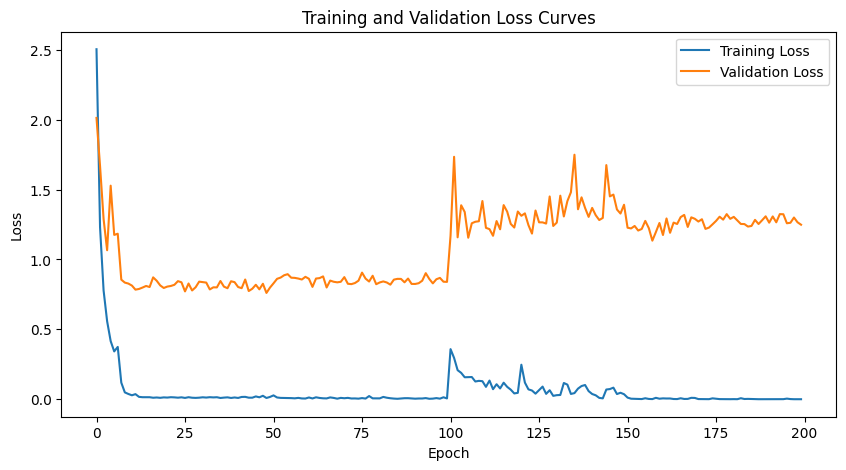

Test Accuracy: 0.8372, F1 Score: 0.8370


In [ ]:
import os
import torch
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
from torchvision.models import resnet50, ResNet50_Weights
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import accuracy_score, f1_score
from PIL import Image
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define paths
data_path = '/home/smehul/ADRL/animals/animals/animals'

# Define transforms
transform = transforms.Compose([
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomRotation(degrees=15),
    transforms.RandomResizedCrop(size=(224, 224), scale=(0.8, 1.0)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Custom Dataset
class AnimalDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.classes = [d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))]
        self.class_to_idx = {cls_name: i for i, cls_name in enumerate(self.classes)}
        self.images = self._load_images()

    def _load_images(self):
        images = []
        for cls_name in self.classes:
            cls_dir = os.path.join(self.root_dir, cls_name)
            for img_name in os.listdir(cls_dir):
                if img_name.lower().endswith(('.png', '.jpg', '.jpeg', '.tiff', '.bmp', '.gif')):
                    images.append((os.path.join(cls_dir, img_name), self.class_to_idx[cls_name]))
        return images

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path, label = self.images[idx]
        image = Image.open(img_path).convert('RGB')
        
        if self.transform:
            image = self.transform(image)
        
        return image, label

# Create dataset and dataloader
dataset = AnimalDataset(data_path, transform=transform)
train_size = int(0.7 * len(dataset))
val_size = int(0.15 * len(dataset))
test_size = len(dataset) - train_size - val_size
train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(dataset, [train_size, val_size, test_size])

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=4)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=4)

# Load pre-trained ResNet50
model = resnet50(weights=ResNet50_Weights.IMAGENET1K_V2)

# Modify the final fully connected layer
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, 91)  # 91 classes

model = model.to(device)

# Define loss function
criterion = nn.CrossEntropyLoss()

# Hyperparameters
learning_rates = [0.001 , 0.0001]
num_epochs = 50

optimizers = [
    ('Adam', optim.Adam),
]
schedulers = [
        ('Plateau', optim.lr_scheduler.ReduceLROnPlateau),
      ('StepLR', optim.lr_scheduler.StepLR)

  
]

# Initialize lists to store loss values for plotting
train_losses = []
val_losses = []

# Main loop for optimizers, schedulers, and learning rates
for opt_name, opt_fn in optimizers:
    for sch_name, sch_fn in schedulers:
        for lr in learning_rates:
            print(f"Training with {opt_name} optimizer, {sch_name} scheduler, learning rate: {lr}")
            optimizer = opt_fn(model.parameters(), lr=lr)

            if sch_name == 'Plateau':
                scheduler = sch_fn(optimizer, mode='min', factor=0.1, patience=2)
            elif sch_name == 'StepLR':
                scheduler = sch_fn(optimizer, step_size=10, gamma=0.1)  # Adjust step_size and gamma as needed

            best_val_loss = float('inf')
            best_model = None

            for epoch in range(num_epochs):
                model.train()
                running_loss = 0.0
                for inputs, labels in train_loader:
                    inputs, labels = inputs.to(device), labels.to(device)

                    optimizer.zero_grad()
                    outputs = model(inputs)
                    loss = criterion(outputs, labels)
                    loss.backward()
                    optimizer.step()
                    running_loss += loss.item()

                train_loss = running_loss / len(train_loader)
                train_losses.append(train_loss)

                # Validation
                model.eval()
                val_loss = 0.0
                all_preds = []
                all_labels = []
                with torch.no_grad():
                    for inputs, labels in val_loader:
                        inputs, labels = inputs.to(device), labels.to(device)
                        outputs = model(inputs)
                        loss = criterion(outputs, labels)
                        val_loss += loss.item()

                        _, preds = torch.max(outputs, 1)
                        all_preds.extend(preds.cpu().numpy())
                        all_labels.extend(labels.cpu().numpy())

                val_loss = val_loss / len(val_loader)
                val_losses.append(val_loss)

                accuracy = accuracy_score(all_labels, all_preds)
                f1 = f1_score(all_labels, all_preds, average='weighted')

                print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}')
                print(f'Validation Accuracy: {accuracy:.4f}, F1 Score: {f1:.4f}')

                # Check if this is the best model
                if val_loss < best_val_loss:
                    best_val_loss = val_loss
                    best_model = model.state_dict()
                    torch.save(best_model, f'best_model_{opt_name}_{sch_name}_lr{lr}.pth')

                # Pass the validation loss to the scheduler
                scheduler.step(val_loss)

# Plot the loss curves
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.title('Training and Validation Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Load the best model from disk and evaluate on the test set
best_model = torch.load(f'best_model_{optimizers[0][0]}_{schedulers[0][0]}_lr{learning_rates[0]}.pth')
model.load_state_dict(best_model)

model.eval()
all_preds = []
all_labels = []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

test_accuracy = accuracy_score(all_labels, all_preds)
test_f1 = f1_score(all_labels, all_preds, average='weighted')
print(f'Test Accuracy: {test_accuracy:.4f}, F1 Score: {test_f1:.4f}')

#### So, after a point it just just oversoots the optimal solution and we need to save the model at 100 epoch only as seen from the graph. We are saving model with minimum validation loss so that will work. Also, on unseen test data the accuracy and F1 score is 0.8372 and 0.8370 respectively which is good.

github repo for reference - > https://github.com/mehulshrivastava7/Analysis-of-ResNet-18-models/blob/main/smehul_Assgn_2.ipynb


# Comparison of MLP vs ResNet Performance

## Performance Summary

### MLP (trained on decoded latents)
- Validation Accuracy: 0.7298
- Validation F1-score: 0.7275
- Test Accuracy: 0.7038
- Test F1-score: 0.7094

### ResNet (fine-tuned pre-trained model)
- Validation Accuracy: ~0.84
- Test Accuracy: 0.8372
- Test F1-score: 0.8370

## Analysis

1. **Encoder's Latent Space Representation**
   - The MLP's lower performance suggests that the encoder may not be learning an optimal latent space representation.
   - The encoded latents might not capture all the relevant features needed for accurate classification.
   - ResNet, being pre-trained on a large dataset (ImageNet), has likely learned more robust and generalizable features.

2. **GAN Training Stability**
   - GANs are notoriously difficult to train and can be unstable.
   - Adding a classification loss to the GAN training process may have further destabilized the training, leading to suboptimal latent representations.
   - ResNet, not relying on adversarial training, avoids these instability issues.

3. **Feature Hierarchy and Depth**
   - ResNet's deep architecture allows it to learn a hierarchy of features, from low-level to high-level abstractions.
   - The MLP, working on encoded latents, may lack this hierarchical feature representation, limiting its ability to capture complex patterns.

4. **Transfer Learning Advantage**
   - ResNet benefits from transfer learning, leveraging knowledge gained from a diverse set of images (ImageNet).
   - The MLP, trained only on the specific dataset's encoded latents, lacks this broad knowledge base.

5. **End-to-End Learning**
   - ResNet performs end-to-end learning, optimizing feature extraction and classification simultaneously.
   - The MLP relies on a two-step process (encoding then classification), which may lead to information loss or suboptimal feature selection.

6. **Dimensionality and Information Compression**
   - The encoded latents used by the MLP may compress the image information too much, losing crucial details for classification.
   - ResNet works with the full image, potentially preserving more relevant information for the task.

7. **Regularization and Generalization**
   - Pre-trained ResNet models often incorporate effective regularization techniques.
   - The MLP, trained on potentially noisy or imperfect latent representations, may struggle with overfitting or underfitting.

In conclusion, while the GAN-based approach with MLP classification shows promising results, the fine-tuned ResNet demonstrates superior performance. This suggests that for this particular task, leveraging pre-trained models and end-to-end fine-tuning may be more effective than using encoded latent representations from a GAN.

# **Q11** Train a ResNet-based classifier on the 20-class subset of the data (as in problem 6) and report the performance metrics.


## Approach to Model Training

Given the lack of specific instructions regarding model training, we'll explore two approaches:

1. **Training from Scratch**: This approach allows us to tailor the model specifically to our dataset.
2. **Using a Pre-trained Model**: Leveraging transfer learning can be beneficial for smaller datasets.

## Model Selection Rationale

Considering our dataset characteristics:

- **Number of Classes**: 18
- **Average Images per Class**: ~40

We will use **ResNet18** for the following reasons:

- **Dataset Size**: With only about 720 images total (18 * 40), a smaller model is less likely to overfit.
- **Computational Efficiency**: ResNet18 offers a good balance between depth and training speed, making it suitable for our limited dataset.


### Custom Dataset

- A custom `AnimalDataset20` class is defined to load images from specified classes.
- Selected classes include various animals such as antelope, badger, and dog.

### Dataset Splitting

- The dataset is split into:
  - **70% Training**
  - **15% Validation**
  - **15% Testing**

### Data Augmentation

- Random horizontal flips and rotations are applied to augment the training data, because the dataset is small.

### Training Process

- **Loss Function**: Cross-Entropy Loss.
- **Optimizer**: Adam optimizer with a learning rate of 0.001.
- **Learning Rate Scheduler**: Reduces learning rate when validation loss plateaus.
- **Early Stopping**: Implemented to prevent overfitting; stops training if validation loss does not improve for 70 epochs. I know 70 is a large number but when I kept it smaller, the training was getting stopeed under 50-60 epochs only and the accuracy was 50%. So, I increased the patience to 70 epochs hoping for increased accuracy but it is still came close to 50 only.

### Training Loop

- The model is trained for up to 500 epochs with periodic validation.
- Metrics computed during validation include accuracy and F1 score.
- The best model is saved based on validation loss.

### Final Evaluation

- The best model is evaluated on the test set.
- Final metrics: Accuracy and F1 score are reported.


In [ ]:
import os
import torch
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
from torchvision.models import resnet50
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import accuracy_score, f1_score
from PIL import Image
from torch.utils.data import random_split

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define paths
data_path = '/home/smehul/ADRL/animals/animals/animals'

# Define transforms
train_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(20),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    transforms.RandomResizedCrop(224, scale=(0.8, 1.0)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

val_test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Custom Dataset for 20-class subset
class AnimalDataset20(Dataset):
    def __init__(self, root_dir, transform=None, selected_classes=None):
        self.root_dir = root_dir
        self.transform = transform
        if selected_classes:
            self.classes = selected_classes
        else:
            self.classes = [d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))]
        self.class_to_idx = {cls_name: i for i, cls_name in enumerate(self.classes)}
        self.images = self._load_images()

    def _load_images(self):
        images = []
        for cls_name in self.classes:
            cls_dir = os.path.join(self.root_dir, cls_name)
            for img_name in os.listdir(cls_dir):
                if img_name.lower().endswith(('.png', '.jpg', '.jpeg', '.tiff', '.bmp', '.gif')):
                    images.append((os.path.join(cls_dir, img_name), self.class_to_idx[cls_name]))
        return images

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path, label = self.images[idx]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, label

# Specify the 20 classes you want to use
selected_classes = ['antelope', 'badger', 'bat', 'bear', 'bee', 'beetle', 'bison', 'boar', 'butterfly', 'cat',
                    'caterpillar', 'chimpanzee', 'cockroach', 'cow', 'coyote', 'crab', 'crow', 'deer', 'dog', 'dolphin']

dataset = AnimalDataset20(data_path, transform=None, selected_classes=selected_classes)

# Split dataset into train, validation, and test sets
train_size = int(0.7 * len(dataset))   # 70% training
val_size = int(0.15 * len(dataset))    # 15% validation
test_size = len(dataset) - train_size - val_size  # Remaining 15% for testing

train_dataset, val_dataset, test_dataset = random_split(dataset, [train_size, val_size, test_size])

# Apply specific transforms to each dataset
train_dataset.dataset.transform = train_transform
val_dataset.dataset.transform = val_test_transform
test_dataset.dataset.transform = val_test_transform

# Create DataLoaders for train, validation, and test sets
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=4)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=4)

# Load ResNet50 without pre-trained weights (training from scratch)
model = resnet50(weights=None)

# Modify the final fully connected layer for 20 classes
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, 20)  # 20 classes

model = model.to(device)

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Learning rate scheduler: Reduce LR on plateau (if validation loss doesn't improve)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5)

# Early stopping parameters
early_stopping_patience = 70
early_stopping_counter = 0
best_val_loss = float('inf')

# Training loop with early stopping
epochs = 500
for epoch in range(epochs):
    model.train()
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item()
    
    print(f'Epoch {epoch+1}/{epochs}, Loss: {running_loss/len(train_loader):.4f}')
    
    # Validation
    model.eval()
    all_preds = []
    all_labels = []
    val_loss = 0.0
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            
            _, preds = torch.max(outputs, 1)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    # Compute metrics
    accuracy = accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds, average='weighted')
    val_loss /= len(val_loader)
    print(f'Validation Accuracy: {accuracy:.4f}, F1 Score: {f1:.4f}, Val Loss: {val_loss:.4f}')
    
    # Learning rate scheduler step
    scheduler.step(val_loss)
    
    # Early stopping check
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        early_stopping_counter = 0
        torch.save(model.state_dict(), 'best_model.pth')
        print("Model saved.")
    else:
        early_stopping_counter += 1
        if early_stopping_counter >= early_stopping_patience:
            print("Early stopping triggered.")
            break

print("Training completed!")

# Final evaluation on the test set
model.load_state_dict(torch.load('best_model.pth'))  # Load the best model
model.eval()
all_preds = []
all_labels = []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

final_accuracy = accuracy_score(all_labels, all_preds)
final_f1 = f1_score(all_labels, all_preds, average='weighted')
print(f'Final Test Accuracy: {final_accuracy:.4f}, Test F1 Score: {final_f1:.4f}')


Epoch 1/500, Loss: 3.2492
Validation Accuracy: 0.1111, F1 Score: 0.0676, Val Loss: 3.7956
Model saved.
Epoch 2/500, Loss: 2.8662
Validation Accuracy: 0.1111, F1 Score: 0.0697, Val Loss: 26.5533
Epoch 3/500, Loss: 2.7933
Validation Accuracy: 0.1222, F1 Score: 0.0740, Val Loss: 14.5564
Epoch 4/500, Loss: 2.7341
Validation Accuracy: 0.1444, F1 Score: 0.1302, Val Loss: 2.9558
Model saved.
Epoch 5/500, Loss: 2.5663
Validation Accuracy: 0.2167, F1 Score: 0.1985, Val Loss: 3.1535
Epoch 6/500, Loss: 2.4500
Validation Accuracy: 0.2389, F1 Score: 0.2149, Val Loss: 3.1193
Epoch 7/500, Loss: 2.3888
Validation Accuracy: 0.2167, F1 Score: 0.2159, Val Loss: 3.5494
Epoch 8/500, Loss: 2.3885
Validation Accuracy: 0.2056, F1 Score: 0.1767, Val Loss: 2.6514
Model saved.
Epoch 9/500, Loss: 2.2942
Validation Accuracy: 0.2722, F1 Score: 0.2331, Val Loss: 2.7516
Epoch 10/500, Loss: 2.2562
Validation Accuracy: 0.3056, F1 Score: 0.2608, Val Loss: 2.3575
Model saved.
Epoch 11/500, Loss: 2.1899
Validation Accurac

/tmp/ipykernel_81423/1228501871.py:168: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('best_model.pth'))  # Load the best model


Final Test Accuracy: 0.5056, Test F1 Score: 0.5069


#### LEt's try fine tuning by taking pre-trained weights like last question. 

#### Key Components
1. **Model Definition**: 
   - Loads the pre-trained ResNet50 model and modifies its final layer to output predictions for 20 classes.

2. **Loss and Optimizer**: 
   - Uses cross-entropy loss and Adam optimizer.
   - Implements a learning rate scheduler to adjust learning rates based on validation loss.

3. **Training Loop**:
   - Runs for a maximum of 1000 epochs with early stopping based on validation loss.
   - Computes and prints training loss and validation metrics (accuracy and F1 score).

4. **Model Saving**: 
   - Saves the best-performing model based on validation loss.

5. **Final Evaluation**: 
   - Loads the best model and evaluates its performance on the test set, reporting accuracy and F1 score.


In [ ]:
import os
import torch
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
from torchvision.models import resnet50
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import accuracy_score, f1_score
from PIL import Image
from torch.utils.data import random_split

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define paths
data_path = '/home/smehul/ADRL/animals/animals/animals'

# Define transforms
train_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(20),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    transforms.RandomResizedCrop(224, scale=(0.8, 1.0)),
    transforms.RandomGrayscale(p=0.2),  # Randomly convert to grayscale
    transforms.RandomApply([transforms.RandomErasing()], p=0.5),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])


val_test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Custom Dataset for 20-class subset
class AnimalDataset20(Dataset):
    def __init__(self, root_dir, transform=None, selected_classes=None):
        self.root_dir = root_dir
        self.transform = transform
        if selected_classes:
            self.classes = selected_classes
        else:
            self.classes = [d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))]
        self.class_to_idx = {cls_name: i for i, cls_name in enumerate(self.classes)}
        self.images = self._load_images()

    def _load_images(self):
        images = []
        for cls_name in self.classes:
            cls_dir = os.path.join(self.root_dir, cls_name)
            for img_name in os.listdir(cls_dir):
                if img_name.lower().endswith(('.png', '.jpg', '.jpeg', '.tiff', '.bmp', '.gif')):
                    images.append((os.path.join(cls_dir, img_name), self.class_to_idx[cls_name]))
        return images

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path, label = self.images[idx]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, label

# Specify the 20 classes you want to use
selected_classes = ['antelope', 'badger', 'bat', 'bear', 'bee', 'beetle', 'bison', 'boar', 'butterfly', 'cat',
                    'caterpillar', 'chimpanzee', 'cockroach', 'cow', 'coyote', 'crab', 'crow', 'deer', 'dog', 'dolphin']

dataset = AnimalDataset20(data_path, transform=None, selected_classes=selected_classes)

# Split dataset into train, validation, and test sets
train_size = int(0.7 * len(dataset))   # 70% training
val_size = int(0.15 * len(dataset))    # 15% validation
test_size = len(dataset) - train_size - val_size  # Remaining 15% for testing

train_dataset, val_dataset, test_dataset = random_split(dataset, [train_size, val_size, test_size])

# Apply specific transforms to each dataset
train_dataset.dataset.transform = train_transform
val_dataset.dataset.transform = val_test_transform
test_dataset.dataset.transform = val_test_transform

# Create DataLoaders for train, validation, and test sets
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=4)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=4)

# Load ResNet50 with pre-trained weights
model = resnet50(weights='IMAGENET1K_V1')  # Load pre-trained weights

# Modify the final fully connected layer for 20 classes
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, 20)  # 20 classes

model = model.to(device)

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Learning rate scheduler: Reduce LR on plateau (if validation loss doesn't improve)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5)

# Early stopping parameters
early_stopping_patience = 100
early_stopping_counter = 0
best_val_loss = float('inf')

# Training loop with early stopping
epochs = 1000
for epoch in range(epochs):
    model.train()
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item()
    
    print(f'Epoch {epoch+1}/{epochs}, Loss: {running_loss/len(train_loader):.4f}')
    
    # Validation
    model.eval()
    all_preds = []
    all_labels = []
    val_loss = 0.0
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            
            _, preds = torch.max(outputs, 1)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    # Compute metrics
    accuracy = accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds, average='weighted')
    val_loss /= len(val_loader)
    print(f'Validation Accuracy: {accuracy:.4f}, F1 Score: {f1:.4f}, Val Loss: {val_loss:.4f}')
    
    # Learning rate scheduler step
    scheduler.step(val_loss)
    
    # Early stopping check
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        early_stopping_counter = 0
        torch.save(model.state_dict(), 'best_model_pretrained.pth')
        print("Model saved.")
    else:
        early_stopping_counter += 1
        if early_stopping_counter >= early_stopping_patience:
            print("Early stopping triggered.")
            break

print("Training completed!")

# Final evaluation on the test set
model.load_state_dict(torch.load('best_model_pretrained.pth'))  # Load the best model
model.eval()
all_preds = []
all_labels = []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

final_accuracy = accuracy_score(all_labels, all_preds)
final_f1 = f1_score(all_labels, all_preds, average='weighted')
print(f'Final Test Accuracy: {final_accuracy:.4f}, Test F1 Score: {final_f1:.4f}')


Epoch 1/1000, Loss: 2.1619
Validation Accuracy: 0.2000, F1 Score: 0.1522, Val Loss: 10.8906
Model saved.
Epoch 2/1000, Loss: 1.4409
Validation Accuracy: 0.3333, F1 Score: 0.2961, Val Loss: 3.3094
Model saved.
Epoch 3/1000, Loss: 1.0554
Validation Accuracy: 0.4167, F1 Score: 0.3926, Val Loss: 2.8855
Model saved.
Epoch 4/1000, Loss: 0.9517
Validation Accuracy: 0.4500, F1 Score: 0.4338, Val Loss: 2.9951
Epoch 5/1000, Loss: 0.7726
Validation Accuracy: 0.5722, F1 Score: 0.5715, Val Loss: 1.6639
Model saved.
Epoch 6/1000, Loss: 0.5543
Validation Accuracy: 0.5667, F1 Score: 0.5449, Val Loss: 2.0185
Epoch 7/1000, Loss: 0.4334
Validation Accuracy: 0.4833, F1 Score: 0.4726, Val Loss: 2.2686
Epoch 8/1000, Loss: 0.3825
Validation Accuracy: 0.5944, F1 Score: 0.5901, Val Loss: 1.6718
Epoch 9/1000, Loss: 0.3983
Validation Accuracy: 0.5278, F1 Score: 0.5010, Val Loss: 2.8913
Epoch 10/1000, Loss: 0.3784
Validation Accuracy: 0.5611, F1 Score: 0.5486, Val Loss: 1.8910
Epoch 11/1000, Loss: 0.2920
Validati

/tmp/ipykernel_81423/839766953.py:171: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('best_model_pretrained.pth'))  # Load the best model


Final Test Accuracy: 0.7111, Test F1 Score: 0.7069


#### It improved, like it was suppose to improve we were using pre-trained weights.
#### Now, we can see the accuracy is 70% and F1 score is 0.70, we will try some configurations with fine tuning as we did in the previous question for higher accuracy.

Training with Adam optimizer, Plateau scheduler, learning rate: 0.001
Epoch 1/30, Train Loss: 1.9954, Validation Loss: 4.5119
Validation Accuracy: 0.2389, F1 Score: 0.1948
Epoch 2/30, Train Loss: 1.6308, Validation Loss: 2.8721
Validation Accuracy: 0.3278, F1 Score: 0.2897
Epoch 3/30, Train Loss: 1.0244, Validation Loss: 3.3968
Validation Accuracy: 0.4056, F1 Score: 0.3872
Epoch 4/30, Train Loss: 0.8062, Validation Loss: 2.9651
Validation Accuracy: 0.4333, F1 Score: 0.4334
Epoch 5/30, Train Loss: 0.8459, Validation Loss: 2.0608
Validation Accuracy: 0.5389, F1 Score: 0.5252
Epoch 6/30, Train Loss: 0.5343, Validation Loss: 2.0999
Validation Accuracy: 0.5278, F1 Score: 0.5332
Epoch 7/30, Train Loss: 0.4143, Validation Loss: 1.7778
Validation Accuracy: 0.6333, F1 Score: 0.6182
Epoch 8/30, Train Loss: 0.3376, Validation Loss: 2.1486
Validation Accuracy: 0.6111, F1 Score: 0.5931
Epoch 9/30, Train Loss: 0.4496, Validation Loss: 1.7409
Validation Accuracy: 0.6333, F1 Score: 0.6245
Epoch 10/30,

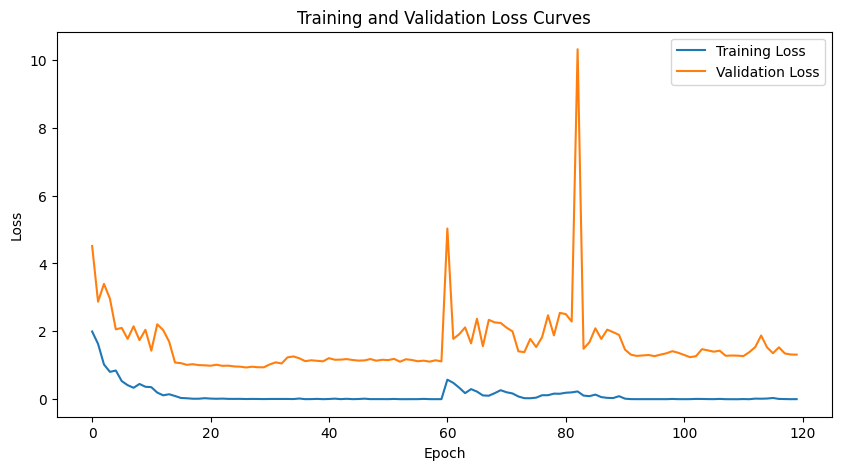

Test Accuracy: 0.7944, F1 Score: 0.7918


In [ ]:
import os
import torch
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
from torchvision.models import resnet50
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import accuracy_score, f1_score
from PIL import Image
from torch.utils.data import random_split
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define paths
data_path = '/home/smehul/ADRL/animals/animals/animals'

# Define transforms
train_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(20),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    transforms.RandomResizedCrop(224, scale=(0.8, 1.0)),
    transforms.RandomGrayscale(p=0.2),  # Randomly convert to grayscale
    transforms.RandomApply([transforms.RandomErasing()], p=0.5),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])


val_test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Custom Dataset for 20-class subset
class AnimalDataset20(Dataset):
    def __init__(self, root_dir, transform=None, selected_classes=None):
        self.root_dir = root_dir
        self.transform = transform
        if selected_classes:
            self.classes = selected_classes
        else:
            self.classes = [d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))]
        self.class_to_idx = {cls_name: i for i, cls_name in enumerate(self.classes)}
        self.images = self._load_images()

    def _load_images(self):
        images = []
        for cls_name in self.classes:
            cls_dir = os.path.join(self.root_dir, cls_name)
            for img_name in os.listdir(cls_dir):
                if img_name.lower().endswith(('.png', '.jpg', '.jpeg', '.tiff', '.bmp', '.gif')):
                    images.append((os.path.join(cls_dir, img_name), self.class_to_idx[cls_name]))
        return images

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path, label = self.images[idx]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, label

# Specify the 20 classes you want to use
selected_classes = ['antelope', 'badger', 'bat', 'bear', 'bee', 'beetle', 'bison', 'boar', 'butterfly', 'cat',
                    'caterpillar', 'chimpanzee', 'cockroach', 'cow', 'coyote', 'crab', 'crow', 'deer', 'dog', 'dolphin']

dataset = AnimalDataset20(data_path, transform=None, selected_classes=selected_classes)

# Split dataset into train, validation, and test sets
train_size = int(0.7 * len(dataset))   # 70% training
val_size = int(0.15 * len(dataset))    # 15% validation
test_size = len(dataset) - train_size - val_size  # Remaining 15% for testing

train_dataset, val_dataset, test_dataset = random_split(dataset, [train_size, val_size, test_size])

# Apply specific transforms to each dataset
train_dataset.dataset.transform = train_transform
val_dataset.dataset.transform = val_test_transform
test_dataset.dataset.transform = val_test_transform

# Create DataLoaders for train, validation, and test sets
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=4)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=4)

# Load ResNet50 with pre-trained weights
model = resnet50(weights='IMAGENET1K_V1')  # Load pre-trained weights

# Modify the final fully connected layer for 20 classes
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, 20)  # 20 classes

model = model.to(device)

# Hyperparameters
learning_rates = [0.001 , 0.0001]
num_epochs = 30

optimizers = [
    ('Adam', optim.Adam)]
schedulers = [
        ('Plateau', optim.lr_scheduler.ReduceLROnPlateau),
      ('StepLR', optim.lr_scheduler.StepLR)

  
]
# Define loss function
criterion = nn.CrossEntropyLoss()
# Initialize lists to store loss values for plotting
train_losses = []
val_losses = []

# Main loop for optimizers, schedulers, and learning rates
for opt_name, opt_fn in optimizers:
    for sch_name, sch_fn in schedulers:
        for lr in learning_rates:
            print(f"Training with {opt_name} optimizer, {sch_name} scheduler, learning rate: {lr}")
            optimizer = opt_fn(model.parameters(), lr=lr)

            if sch_name == 'Plateau':
                scheduler = sch_fn(optimizer, mode='min', factor=0.1, patience=2)
            elif sch_name == 'StepLR':
                scheduler = sch_fn(optimizer, step_size=10, gamma=0.1)  # Adjust step_size and gamma as needed

            best_val_loss = float('inf')
            best_model = None

            for epoch in range(num_epochs):
                model.train()
                running_loss = 0.0
                for inputs, labels in train_loader:
                    inputs, labels = inputs.to(device), labels.to(device)

                    optimizer.zero_grad()
                    outputs = model(inputs)
                    loss = criterion(outputs, labels)
                    loss.backward()
                    optimizer.step()
                    running_loss += loss.item()

                train_loss = running_loss / len(train_loader)
                train_losses.append(train_loss)

                # Validation
                model.eval()
                val_loss = 0.0
                all_preds = []
                all_labels = []
                with torch.no_grad():
                    for inputs, labels in val_loader:
                        inputs, labels = inputs.to(device), labels.to(device)
                        outputs = model(inputs)
                        loss = criterion(outputs, labels)
                        val_loss += loss.item()

                        _, preds = torch.max(outputs, 1)
                        all_preds.extend(preds.cpu().numpy())
                        all_labels.extend(labels.cpu().numpy())

                val_loss = val_loss / len(val_loader)
                val_losses.append(val_loss)

                accuracy = accuracy_score(all_labels, all_preds)
                f1 = f1_score(all_labels, all_preds, average='weighted')

                print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}')
                print(f'Validation Accuracy: {accuracy:.4f}, F1 Score: {f1:.4f}')

                # Check if this is the best model
                if val_loss < best_val_loss:
                    best_val_loss = val_loss
                    best_model = model.state_dict()
                    torch.save(best_model, f'best_model_{opt_name}_{sch_name}_lr{lr}.pth')

                # Pass the validation loss to the scheduler
                scheduler.step(val_loss)

# Plot the loss curves
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.title('Training and Validation Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Load the best model from disk and evaluate on the test set
best_model = torch.load(f'best_model_{optimizers[0][0]}_{schedulers[0][0]}_lr{learning_rates[0]}.pth')
model.load_state_dict(best_model)

model.eval()
all_preds = []
all_labels = []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

test_accuracy = accuracy_score(all_labels, all_preds)
test_f1 = f1_score(all_labels, all_preds, average='weighted')
print(f'Test Accuracy: {test_accuracy:.4f}, F1 Score: {test_f1:.4f}')

#### On unseen test set we got 0.7944 accuracy and 0.7918 F1 score.

### Q 12: c-GAN Augmentation & Classifier Retraining

- **Generate Images**: Utilize the c-GAN from Problem 6 to generate 100 additional images per class for all 20 classes.
- **Retrain Classifier**: Use the augmented dataset to retrain the ResNet50 classifier.
- **Comparison**: Compare the performance of the retrained classifier with the model trained without augmentation.


#### Code to generate 100 images per class using the c-GAN model from Problem 6.

In [ ]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
import torchvision.utils as vutils
import matplotlib.pyplot as plt

BATCH_SIZE = 32  # Reduced batch size
EPOCHS = 200  # Increased number of epochs
LATENT_DIM = 128  # Increased latent dimension
NUM_CLASSES = 20
IMAGE_SIZE = 128  # Increased image size
CHANNELS = 3
LEARNING_RATE = 0.0002
BETA1 = 0.5

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.label_emb = nn.Embedding(NUM_CLASSES, NUM_CLASSES)
        
        self.model = nn.Sequential(
            nn.Linear(LATENT_DIM + NUM_CLASSES, 8 * 8 * 512),  # Adjust for input size 128
            nn.BatchNorm1d(8 * 8 * 512),
            nn.ReLU(True),
            nn.Unflatten(1, (512, 8, 8)),  # Adjust for new feature map size
            nn.ConvTranspose2d(512, 256, 4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, CHANNELS, 4, stride=2, padding=1),
            nn.Tanh()
        )

    def forward(self, noise, labels):
        labels = self.label_emb(labels)
        x = torch.cat([noise, labels], 1)
        return self.model(x)


def load_generator_weights(generator, weights_path):
    # Load the generator weights from the specified path
    generator.load_state_dict(torch.load(weights_path))
    generator.eval()  # Set the generator to evaluation mode
    print(f"Loaded generator weights from {weights_path}")

def generate_images(num_images, label):
    noise = torch.randn(num_images, LATENT_DIM, device=device)
    labels = torch.full((num_images,), label, dtype=torch.long, device=device)
    with torch.no_grad():
        generated_images = generator(noise, labels)
    return generated_images

def save_images_per_class(output_dir, num_images_per_class=100):
    # Ensure the output directory exists
    os.makedirs(output_dir, exist_ok=True)
    
    for label in range(NUM_CLASSES):
        # Create a subdirectory for each class
        class_dir = os.path.join(output_dir, f'class_{label}')
        os.makedirs(class_dir, exist_ok=True)
        
        # Generate the specified number of images for the class
        class_images = generate_images(num_images=num_images_per_class, label=label)
        
        # Save each image separately in the class directory
        for i in range(num_images_per_class):
            img_path = os.path.join(class_dir, f'image_{i+1}.png')
            # Extract and save the individual image
            vutils.save_image(class_images[i], img_path, normalize=True)
        
        print(f"Saved {num_images_per_class} images for class {label} in {class_dir}")

# Example usage:
output_directory = "generated_images"
weights_path = 'generator_model2.pth'  # Path to your saved generator weights

# initialize the generator model
generator = Generator().to(device)

# Load the generator weights before generating images
load_generator_weights(generator, weights_path)

# Generate and save 100 images per class
save_images_per_class(output_directory, num_images_per_class=100)


/tmp/ipykernel_3093912/505054609.py:53: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weights_path))


Loaded generator weights from generator_model2.pth
Saved 100 images for class 0 in generated_images/class_0
Saved 100 images for class 1 in generated_images/class_1
Saved 100 images for class 2 in generated_images/class_2
Saved 100 images for class 3 in generated_images/class_3
Saved 100 images for class 4 in generated_images/class_4
Saved 100 images for class 5 in generated_images/class_5
Saved 100 images for class 6 in generated_images/class_6
Saved 100 images for class 7 in generated_images/class_7
Saved 100 images for class 8 in generated_images/class_8
Saved 100 images for class 9 in generated_images/class_9
Saved 100 images for class 10 in generated_images/class_10
Saved 100 images for class 11 in generated_images/class_11
Saved 100 images for class 12 in generated_images/class_12
Saved 100 images for class 13 in generated_images/class_13
Saved 100 images for class 14 in generated_images/class_14
Saved 100 images for class 15 in generated_images/class_15
Saved 100 images for clas

#### Running the same code as Q11 but using this data, same division for train, validation and test set and same hyperparameters as Q11.

Training with Adam optimizer, Plateau scheduler, learning rate: 0.001
Epoch 1/30, Train Loss: 0.4751, Validation Loss: 1.1438
Validation Accuracy: 0.7000, F1 Score: 0.6699
Epoch 2/30, Train Loss: 0.0608, Validation Loss: 0.0535
Validation Accuracy: 0.9867, F1 Score: 0.9865
Epoch 3/30, Train Loss: 0.0149, Validation Loss: 0.0037
Validation Accuracy: 1.0000, F1 Score: 1.0000
Epoch 4/30, Train Loss: 0.0040, Validation Loss: 0.0040
Validation Accuracy: 1.0000, F1 Score: 1.0000
Epoch 5/30, Train Loss: 0.0128, Validation Loss: 0.4191
Validation Accuracy: 0.8567, F1 Score: 0.8691
Epoch 6/30, Train Loss: 0.0385, Validation Loss: 0.1655
Validation Accuracy: 0.9467, F1 Score: 0.9469
Epoch 7/30, Train Loss: 0.0114, Validation Loss: 0.0019
Validation Accuracy: 1.0000, F1 Score: 1.0000
Epoch 8/30, Train Loss: 0.0026, Validation Loss: 0.0009
Validation Accuracy: 1.0000, F1 Score: 1.0000
Epoch 9/30, Train Loss: 0.0013, Validation Loss: 0.0006
Validation Accuracy: 1.0000, F1 Score: 1.0000
Epoch 10/30,

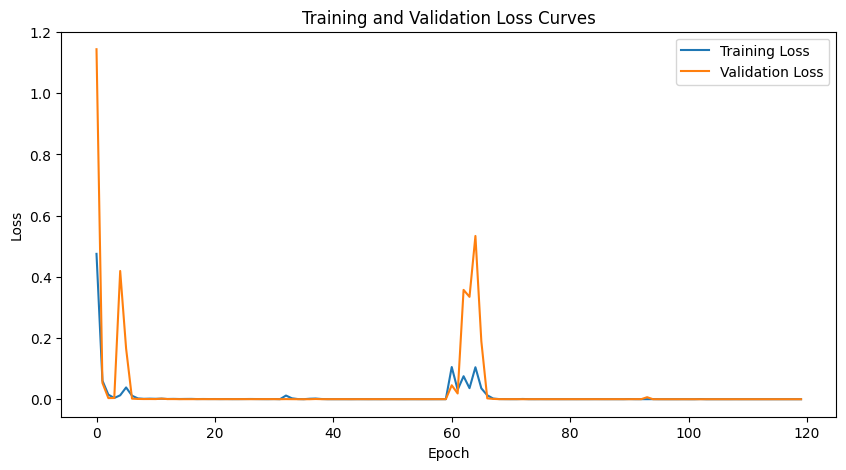

Test Accuracy: 1.0000, F1 Score: 1.0000


In [ ]:
import os
import torch
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
from torchvision.models import resnet50
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import accuracy_score, f1_score
from PIL import Image
from torch.utils.data import random_split
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define paths
data_path = 'generated_images'  # Path to the directory containing generated images

# Define transforms
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Custom Dataset for GAN-generated images
class GANGeneratedDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.classes = [d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))]
        self.class_to_idx = {cls_name: i for i, cls_name in enumerate(self.classes)}
        self.images = self._load_images()

    def _load_images(self):
        images = []
        for cls_name in self.classes:
            cls_dir = os.path.join(self.root_dir, cls_name)
            for img_name in os.listdir(cls_dir):
                if img_name.lower().endswith(('.png', '.jpg', '.jpeg')):
                    images.append((os.path.join(cls_dir, img_name), self.class_to_idx[cls_name]))
        return images

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path, label = self.images[idx]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, label

# Create dataset
dataset = GANGeneratedDataset(data_path, transform=transform)

# Split dataset into train, validation, and test sets
train_size = int(0.7 * len(dataset))
val_size = int(0.15 * len(dataset))
test_size = len(dataset) - train_size - val_size

train_dataset, val_dataset, test_dataset = random_split(dataset, [train_size, val_size, test_size])

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=4)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=4)

# Load ResNet50 with pre-trained weights
model = resnet50(weights='IMAGENET1K_V1')

# Modify the final fully connected layer for 20 classes
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, 20)  # 20 classes

model = model.to(device)

# Hyperparameters
learning_rates = [0.001, 0.0001]
num_epochs = 30

optimizers = [('Adam', optim.Adam)]
schedulers = [
    ('Plateau', optim.lr_scheduler.ReduceLROnPlateau),
    ('StepLR', optim.lr_scheduler.StepLR)
]

# Define loss function
criterion = nn.CrossEntropyLoss()

# Initialize lists to store loss values for plotting
train_losses = []
val_losses = []

# Main training loop
for opt_name, opt_fn in optimizers:
    for sch_name, sch_fn in schedulers:
        for lr in learning_rates:
            print(f"Training with {opt_name} optimizer, {sch_name} scheduler, learning rate: {lr}")
            optimizer = opt_fn(model.parameters(), lr=lr)

            if sch_name == 'Plateau':
                scheduler = sch_fn(optimizer, mode='min', factor=0.1, patience=2)
            elif sch_name == 'StepLR':
                scheduler = sch_fn(optimizer, step_size=10, gamma=0.1)

            best_val_loss = float('inf')
            best_model = None

            for epoch in range(num_epochs):
                model.train()
                running_loss = 0.0
                for inputs, labels in train_loader:
                    inputs, labels = inputs.to(device), labels.to(device)

                    optimizer.zero_grad()
                    outputs = model(inputs)
                    loss = criterion(outputs, labels)
                    loss.backward()
                    optimizer.step()
                    running_loss += loss.item()

                train_loss = running_loss / len(train_loader)
                train_losses.append(train_loss)

                # Validation
                model.eval()
                val_loss = 0.0
                all_preds = []
                all_labels = []
                with torch.no_grad():
                    for inputs, labels in val_loader:
                        inputs, labels = inputs.to(device), labels.to(device)
                        outputs = model(inputs)
                        loss = criterion(outputs, labels)
                        val_loss += loss.item()

                        _, preds = torch.max(outputs, 1)
                        all_preds.extend(preds.cpu().numpy())
                        all_labels.extend(labels.cpu().numpy())

                val_loss = val_loss / len(val_loader)
                val_losses.append(val_loss)

                accuracy = accuracy_score(all_labels, all_preds)
                f1 = f1_score(all_labels, all_preds, average='weighted')

                print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}')
                print(f'Validation Accuracy: {accuracy:.4f}, F1 Score: {f1:.4f}')

                # Check if this is the best model
                if val_loss < best_val_loss:
                    best_val_loss = val_loss
                    best_model = model.state_dict()
                    torch.save(best_model, f'best_model_gan_{opt_name}_{sch_name}_lr{lr}.pth')

                # Step the scheduler
                if sch_name == 'Plateau':
                    scheduler.step(val_loss)
                elif sch_name == 'StepLR':
                    scheduler.step()

# Plot the loss curves
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.title('Training and Validation Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Load the best model and evaluate on the test set
best_model = torch.load(f'best_model_gan_{optimizers[0][0]}_{schedulers[0][0]}_lr{learning_rates[0]}.pth')
model.load_state_dict(best_model)

model.eval()
all_preds = []
all_labels = []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

test_accuracy = accuracy_score(all_labels, all_preds)
test_f1 = f1_score(all_labels, all_preds, average='weighted')
print(f'Test Accuracy: {test_accuracy:.4f}, F1 Score: {test_f1:.4f}')

😯😯, we got 100%, the only change this code has from code in Q11 was of data augmentation becuase we already are using augmentated data, I didn't use it, let's try with it also.

Training with Adam optimizer, Plateau scheduler, learning rate: 0.001
Epoch 1/30, Train Loss: 1.2740, Validation Loss: 5.6060
Validation Accuracy: 0.2967, F1 Score: 0.2473
Epoch 2/30, Train Loss: 0.3054, Validation Loss: 0.7774
Validation Accuracy: 0.8100, F1 Score: 0.8115
Epoch 3/30, Train Loss: 0.2328, Validation Loss: 0.3358
Validation Accuracy: 0.9100, F1 Score: 0.9009
Epoch 4/30, Train Loss: 0.1685, Validation Loss: 0.3726
Validation Accuracy: 0.8833, F1 Score: 0.8843
Epoch 5/30, Train Loss: 0.0961, Validation Loss: 0.1296
Validation Accuracy: 0.9700, F1 Score: 0.9705
Epoch 6/30, Train Loss: 0.1130, Validation Loss: 0.0961
Validation Accuracy: 0.9667, F1 Score: 0.9666
Epoch 7/30, Train Loss: 0.0932, Validation Loss: 0.1487
Validation Accuracy: 0.9500, F1 Score: 0.9482
Epoch 8/30, Train Loss: 0.1196, Validation Loss: 0.1710
Validation Accuracy: 0.9433, F1 Score: 0.9408
Epoch 9/30, Train Loss: 0.0843, Validation Loss: 0.1314
Validation Accuracy: 0.9633, F1 Score: 0.9637
Epoch 10/30,

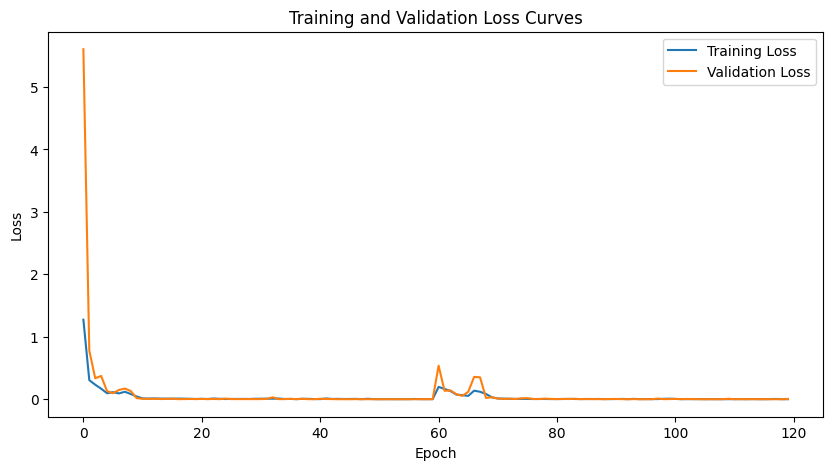

Test Accuracy: 0.9967, F1 Score: 0.9967


In [ ]:
import os
import torch
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
from torchvision.models import resnet50
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import accuracy_score, f1_score
from PIL import Image
from torch.utils.data import random_split
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define paths
data_path = 'generated_images'  # Path to the directory containing generated images

# Define transforms
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(20),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Custom Dataset for GAN-generated images
class GANGeneratedDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.classes = [d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))]
        self.class_to_idx = {cls_name: i for i, cls_name in enumerate(self.classes)}
        self.images = self._load_images()

    def _load_images(self):
        images = []
        for cls_name in self.classes:
            cls_dir = os.path.join(self.root_dir, cls_name)
            for img_name in os.listdir(cls_dir):
                if img_name.lower().endswith(('.png', '.jpg', '.jpeg')):
                    images.append((os.path.join(cls_dir, img_name), self.class_to_idx[cls_name]))
        return images

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path, label = self.images[idx]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, label

# Create dataset
dataset = GANGeneratedDataset(data_path, transform=transform)

# Split dataset into train, validation, and test sets
train_size = int(0.7 * len(dataset))
val_size = int(0.15 * len(dataset))
test_size = len(dataset) - train_size - val_size

train_dataset, val_dataset, test_dataset = random_split(dataset, [train_size, val_size, test_size])

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=4)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=4)

# Load ResNet50 with pre-trained weights
model = resnet50(weights='IMAGENET1K_V1')

# Modify the final fully connected layer for 20 classes
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, 20)  # 20 classes

model = model.to(device)

# Hyperparameters
learning_rates = [0.001, 0.0001]
num_epochs = 30

optimizers = [('Adam', optim.Adam)]
schedulers = [
    ('Plateau', optim.lr_scheduler.ReduceLROnPlateau),
    ('StepLR', optim.lr_scheduler.StepLR)
]

# Define loss function
criterion = nn.CrossEntropyLoss()

# Initialize lists to store loss values for plotting
train_losses = []
val_losses = []

# Main training loop
for opt_name, opt_fn in optimizers:
    for sch_name, sch_fn in schedulers:
        for lr in learning_rates:
            print(f"Training with {opt_name} optimizer, {sch_name} scheduler, learning rate: {lr}")
            optimizer = opt_fn(model.parameters(), lr=lr)

            if sch_name == 'Plateau':
                scheduler = sch_fn(optimizer, mode='min', factor=0.1, patience=2)
            elif sch_name == 'StepLR':
                scheduler = sch_fn(optimizer, step_size=10, gamma=0.1)

            best_val_loss = float('inf')
            best_model = None

            for epoch in range(num_epochs):
                model.train()
                running_loss = 0.0
                for inputs, labels in train_loader:
                    inputs, labels = inputs.to(device), labels.to(device)

                    optimizer.zero_grad()
                    outputs = model(inputs)
                    loss = criterion(outputs, labels)
                    loss.backward()
                    optimizer.step()
                    running_loss += loss.item()

                train_loss = running_loss / len(train_loader)
                train_losses.append(train_loss)

                # Validation
                model.eval()
                val_loss = 0.0
                all_preds = []
                all_labels = []
                with torch.no_grad():
                    for inputs, labels in val_loader:
                        inputs, labels = inputs.to(device), labels.to(device)
                        outputs = model(inputs)
                        loss = criterion(outputs, labels)
                        val_loss += loss.item()

                        _, preds = torch.max(outputs, 1)
                        all_preds.extend(preds.cpu().numpy())
                        all_labels.extend(labels.cpu().numpy())

                val_loss = val_loss / len(val_loader)
                val_losses.append(val_loss)

                accuracy = accuracy_score(all_labels, all_preds)
                f1 = f1_score(all_labels, all_preds, average='weighted')

                print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}')
                print(f'Validation Accuracy: {accuracy:.4f}, F1 Score: {f1:.4f}')

                # Check if this is the best model
                if val_loss < best_val_loss:
                    best_val_loss = val_loss
                    best_model = model.state_dict()
                    torch.save(best_model, f'best_model_gan_{opt_name}_{sch_name}_lr{lr}.pth')

                # Step the scheduler
                if sch_name == 'Plateau':
                    scheduler.step(val_loss)
                elif sch_name == 'StepLR':
                    scheduler.step()

# Plot the loss curves
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.title('Training and Validation Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Load the best model and evaluate on the test set
best_model = torch.load(f'best_model_gan_{optimizers[0][0]}_{schedulers[0][0]}_lr{learning_rates[0]}.pth')
model.load_state_dict(best_model)

model.eval()
all_preds = []
all_labels = []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

test_accuracy = accuracy_score(all_labels, all_preds)
test_f1 = f1_score(all_labels, all_preds, average='weighted')
print(f'Test Accuracy: {test_accuracy:.4f}, F1 Score: {test_f1:.4f}')

### Possible Reasons for High Accuracy on c-GAN Generated Images

1. **Low Diversity in Generated Data**
   - **What it is**: The generated images may lack sufficient variation and diversity compared to real-world data, making them easier for the classifier to distinguish.
   - **Impact**: If the generated images are too similar or not challenging enough, the classifier might find it trivial to achieve high accuracy, which wouldn't generalize well to real data.

2. **Overfitting to Augmented Data**
   - **What it is**: If the classifier was trained primarily on the c-GAN-generated images, it may overfit to the specific characteristics of these synthetic samples.
   - **Impact**: This results in high accuracy on the synthetic data, but the validation and test accuracy is also high so this is not the case.

3. **Imbalance Between Real and Synthetic Data**
   - **What it is**: If the training dataset is dominated by c-GAN-generated images rather than a balance of real and synthetic images, the model may bias its learning toward recognizing synthetic features.
   - **Impact**: The classifier may become overly reliant on features present in the generated images rather than learning general features from real data.

I think the reason is third one.

